# Click to Cart: A Predictive Modeling Task

## Problem Statement

Understanding and predicting customer purchasing behavior is critical for optimizing digital marketing, personalizing user experiences, and driving revenue growth in e-commerce. For this task, you will leverage session-level customer interaction data to predict whether a user will make a purchase during their visit.

## Context

This challenge mirrors real-world scenarios faced by e-commerce platforms, where businesses aim to:

1. Anticipate purchasing intent to tailor real-time recommendations.
2. Optimize ad spend by targeting high-intent users.
3. Reduce bounce rates by identifying and addressing friction points in user journeys.

You are provided with anonymized behavioral data from an e-commerce platform, simulating the complexity of real-world environments. The dataset includes noise, irrelevant features, and subtle patterns to test your ability to extract meaningful signals.

## Data Overview

<h3 style="color: blue; text-decoration: underline;">
  <a href="https://docs.google.com/spreadsheets/d/1JnLk4lz5tkqHDS-TsxRtnY0BZuF2h5wb507DHcKMqbE/edit?gid=1392251919#gid=1392251919" target="_blank">
    customer_behavior_train.csv
  </a>
</h3>
Contains labeled session data with features such as time spent, pages viewed, ad interactions, and device type. The target variable purchase_made is binary (1 for purchase, 0 otherwise).

<h3 style="color: blue; text-decoration: underline;">
  <a href="https://docs.google.com/spreadsheets/d/19u5gJrYj7IUDeJgOhJ5xVHPb3XvnTD5FVS-slwEaiyk/edit?gid=706696439#gid=706696439" target="_blank">
    customer_behavior_test.csv
  </a>
</h3>

Excludes the target variable and non-predictive metadata (e.g., session UUIDs)




### Features:
1. Time_on_site (float): Time (in minutes) the customer spent on the website during the session.
2. Pages_viewed (float): Approximate number of pages visited in the session.
3. Clicked_ad (binary): (i) Indicates whether the user clicked on a product advertisement (ii) Values: 0 (No), 1 (Yes)
4. Cart_value (float):(i) Total value of products in the user's cart during the session (in USD) (ii) May contain zeros (for those who did not add to cart).
5. Referral (categorical):(i) Source from where the user was referred (ii) Values: Google, Facebook, Instagram, Direct
6. Browser_Refresh_Rate (float): A synthetic distracting feature simulating technical metrics.
7. Last_Ad_Seen (categorical): The name of the last ad campaign seen by the user. Values: “X5”, “Y3”, “Z9”, “None”



## Key Challenges

1. Noise: Irrelevant columns (e.g., duplicate metrics, logging artifacts) are included to test feature selection skills.

2. Temporal Dynamics: Session patterns may vary by time of day, promotional campaigns, or seasonal trends.

3. Class Imbalance: Purchases are rare events, requiring careful handling of skewed distributions

## Objective

### Build a robust predictive model to classify user sessions as purchase intent (1) or no purchase (0). Use the training data to engineer features, select models, and validate performance.

In [38]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [40]:
train = pd.read_csv("KodeinKgp Task/customer_behavior_train.csv")
train  

,Time_on_site,Pages_viewed,Clicked_ad,Cart_value,Referral,Browser_Refresh_Rate,Last_Ad_Seen,Purchase
0,2.29,5.37,1,10.00,Facebook,143.14,D,1
1,7.49,16.36,0,25.52,Instagram,136.66,A,1
2,5.71,13.69,0,10.00,Google,67.13,C,0
3,1.23,3.22,1,41.49,Google,92.12,C,0
4,3.55,10.72,0,21.57,Direct,70.31,B,0
...,...,...,...,...,...,...,...,...
1795,4.99,11.27,0,53.20,Facebook,90.52,B,0
1796,3.92,8.20,0,46.06,Google,85.45,A,0
1797,4.63,8.95,0,38.75,Google,99.26,D,0
1798,7.90,23.95,0,70.82,Google,153.03,D,1


In [42]:
test = pd.read_csv("KodeinKgp Task/customer_behavior_test.csv")
test

,Time_on_site,Pages_viewed,Clicked_ad,Cart_value,Referral,Browser_Refresh_Rate,Last_Ad_Seen,Purchase
0,3.33,12.76,0,27.66,Google,131.60,C,0
1,3.75,10.20,0,15.05,Direct,41.63,C,0
2,6.55,16.40,0,105.27,Facebook,98.72,A,1
3,6.42,19.68,1,21.17,Direct,180.20,D,0
4,8.38,30.59,0,91.31,Instagram,58.70,B,1
...,...,...,...,...,...,...,...,...
445,2.32,5.81,1,24.87,Google,65.37,D,0
446,6.76,13.60,0,21.42,Facebook,92.84,A,0
447,3.78,10.62,0,50.71,Google,148.14,A,0
448,3.84,8.17,1,30.11,Instagram,43.91,C,0


# Exploratory Data Analysis (EDA)

## Visualizing the dataset

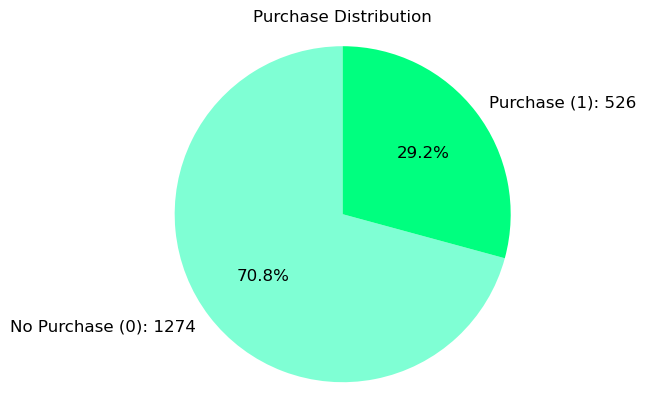

In [46]:
counts = train['Purchase'].value_counts().sort_index() 
names = ['No Purchase (0)', 'Purchase (1)']
labels = [f"{name}: {count}" for name, count in zip(names, counts)]


fig, ax = plt.subplots()
ax.pie(
    counts,
    labels=labels,
    autopct='%1.1f%%',  
    startangle=90,   
    colors=['aquamarine', 'springgreen'],
    textprops={'fontsize': 12}
)


ax.axis('equal')
plt.title("Purchase Distribution")
plt.show()

## Insights: Importance of the time spent by a user on website 

<Axes: xlabel='Time_on_site', ylabel='Pages_viewed'>

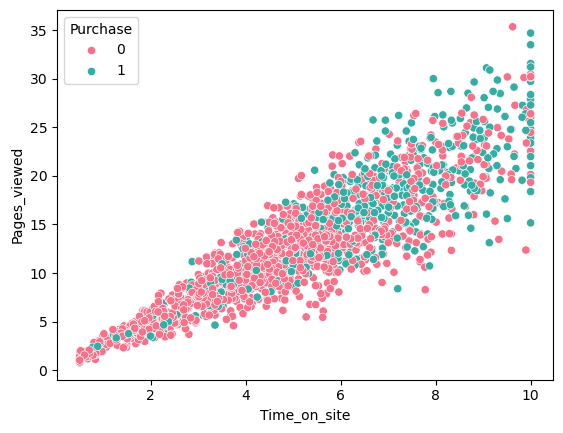

In [48]:
sns.scatterplot(
    data=train,
    x="Time_on_site",
    y="Pages_viewed",
    hue="Purchase", 
    palette="husl", 
    alpha= 1.0 
)

## Insight: Potential uplift from ad campaigns.

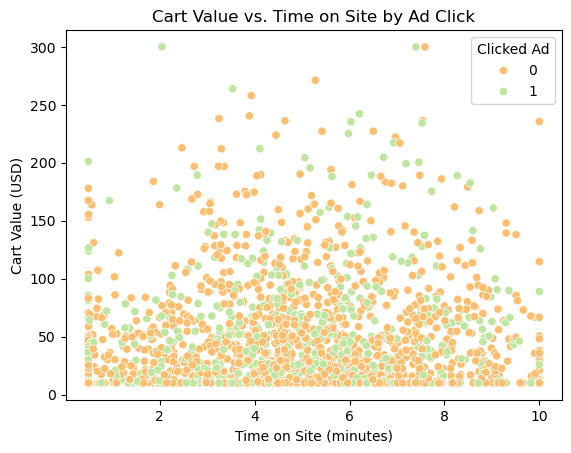

In [50]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.scatterplot(
    data=train,
    x="Time_on_site",
    y="Cart_value",
    hue="Clicked_ad",       
    palette="Spectral",    
    alpha=1.0             
)

plt.title("Cart Value vs. Time on Site by Ad Click")
plt.xlabel("Time on Site (minutes)")
plt.ylabel("Cart Value (USD)")
plt.legend(title="Clicked Ad")
plt.show()


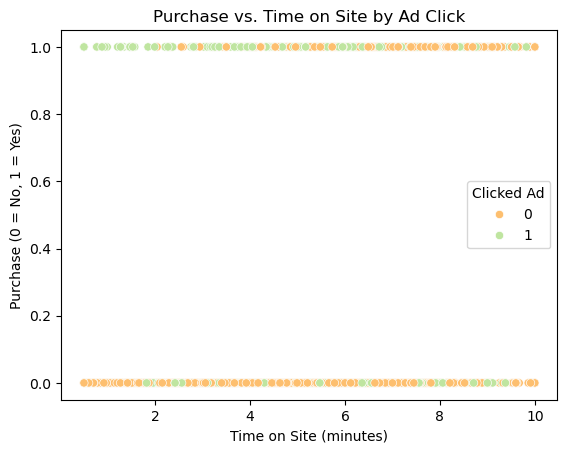

In [51]:
sns.scatterplot(
    data=train,
    x="Time_on_site",
    y="Purchase",
    hue="Clicked_ad",
    palette="Spectral",
    alpha=1.0
)

plt.title("Purchase vs. Time on Site by Ad Click")
plt.xlabel("Time on Site (minutes)")
plt.ylabel("Purchase (0 = No, 1 = Yes)")
plt.legend(title="Clicked Ad")
plt.show()

##  Covering important aspects recieved from referral sources (e.g., Google vs. Direct)

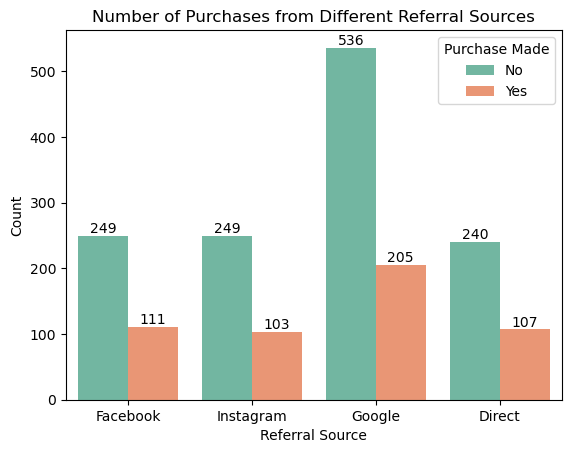

In [53]:
ax1 = sns.countplot(data=train, x='Referral', hue='Purchase', palette='Set2')
ax1.bar_label(ax1.containers[0])
ax1.bar_label(ax1.containers[1])
plt.title('Number of Purchases from Different Referral Sources')
plt.xlabel('Referral Source')
plt.ylabel('Count')
plt.legend(title='Purchase Made', labels=['No', 'Yes'])
plt.show()

<Axes: xlabel='Referral', ylabel='Cart_value'>

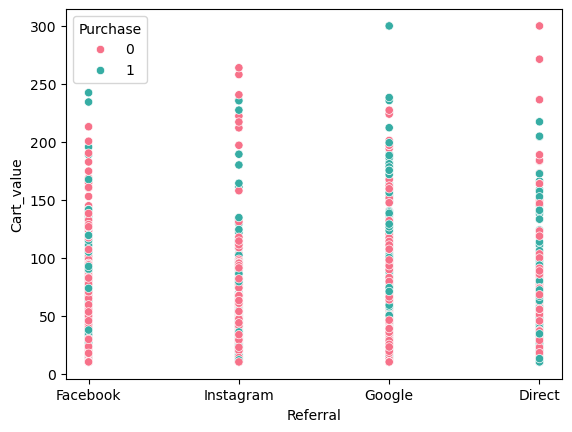

In [54]:
sns.scatterplot(
    data=train,
    x="Referral",
    y="Cart_value",
    hue="Purchase",  
    palette="husl",  
    alpha= 1.0)

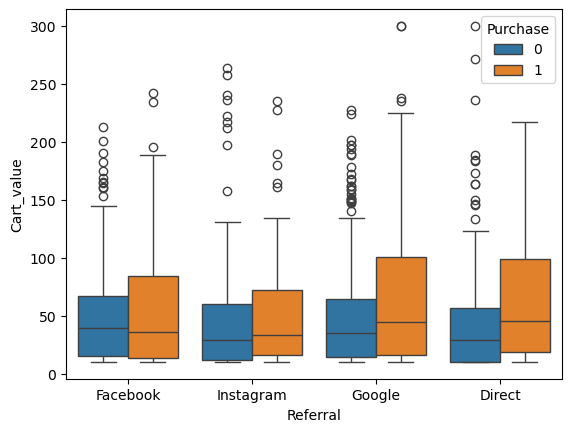

In [55]:
sns.boxplot(x="Referral", y="Cart_value", hue="Purchase", data=train)
plt.show()

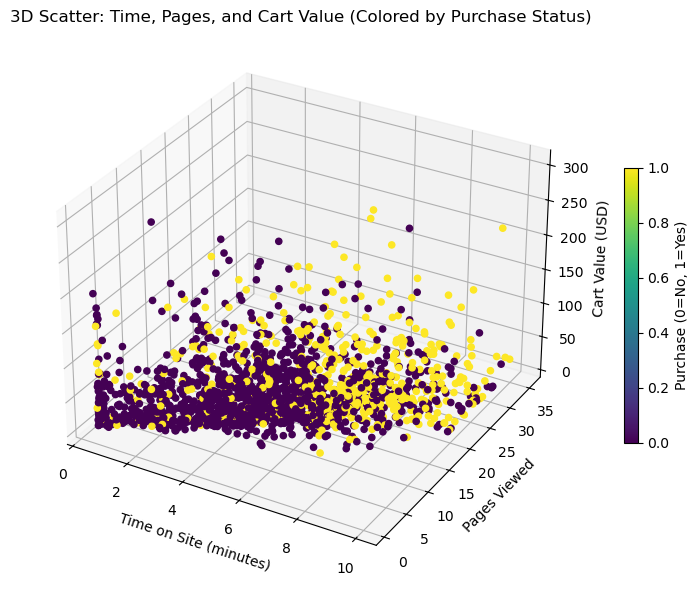

In [56]:
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d') 

ax.scatter3D(
    xs=train['Time_on_site'],
    ys=train['Pages_viewed'],
    zs=train['Cart_value'],
    c=train['Purchase'],  
    cmap='viridis',      
    alpha=1.0            
)

ax.set_xlabel('Time on Site (minutes)')
ax.set_ylabel('Pages Viewed')
ax.set_zlabel('Cart Value (USD)')
plt.title('3D Scatter: Time, Pages, and Cart Value (Colored by Purchase Status)')

plt.colorbar(ax.collections[0], label='Purchase (0=No, 1=Yes)', shrink=0.5)

plt.tight_layout()
plt.show()


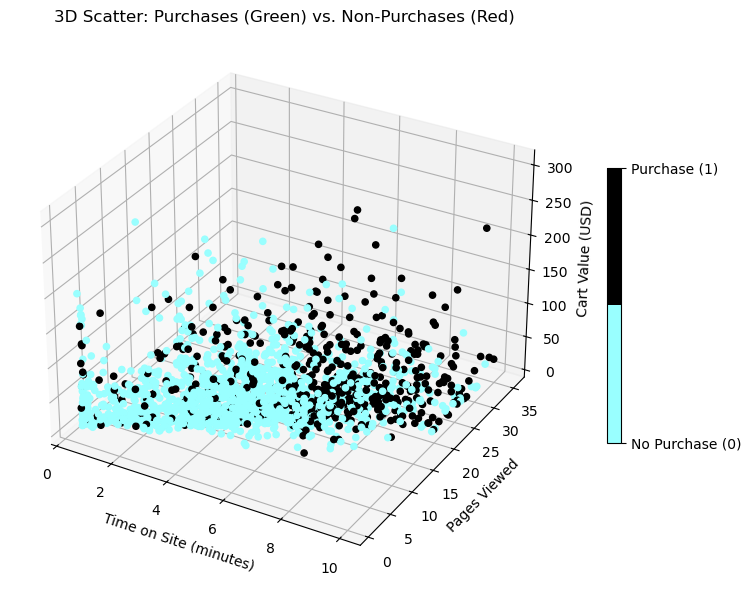

In [57]:
from matplotlib.colors import ListedColormap 
custom_cmap = ListedColormap(['#99FFFF', '#000000'])


fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter3D(
    xs=train['Time_on_site'],
    ys=train['Pages_viewed'],
    zs=train['Cart_value'],
    c=train['Purchase'], 
    cmap=custom_cmap,    
    alpha=1.0
)

ax.set_xlabel('Time on Site (minutes)')
ax.set_ylabel('Pages Viewed')
ax.set_zlabel('Cart Value (USD)')
plt.title('3D Scatter: Purchases (Green) vs. Non-Purchases (Red)')

cbar = plt.colorbar(scatter,shrink=0.5)
cbar.set_ticks([0, 1])
cbar.set_ticklabels(['No Purchase (0)', 'Purchase (1)'])

plt.tight_layout()
plt.show()


## Checking if specific ad campaigns (A,B,C,D) drive higher cart values.

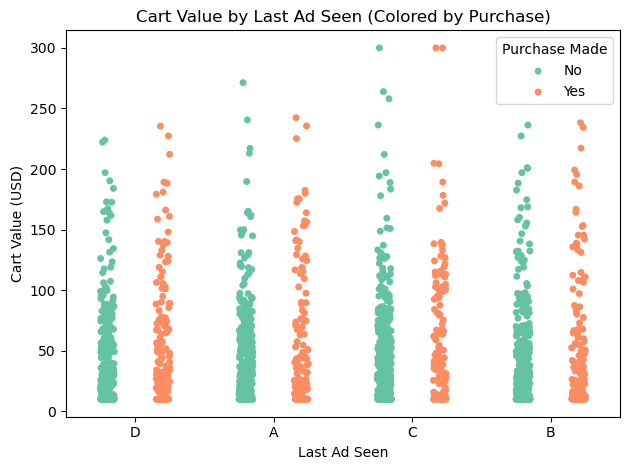

In [59]:
sns.stripplot(
    data=train,
    x='Last_Ad_Seen',
    y='Cart_value',
    hue='Purchase',
    dodge=True,##(I have Used dodge=True to separate purchase/non-purchase points)
    palette='Set2'
)
plt.title('Cart Value by Last Ad Seen (Colored by Purchase)')
plt.xlabel('Last Ad Seen')
plt.ylabel('Cart Value (USD)')
plt.legend(title='Purchase Made', labels=['No', 'Yes'])
plt.tight_layout()
plt.show()

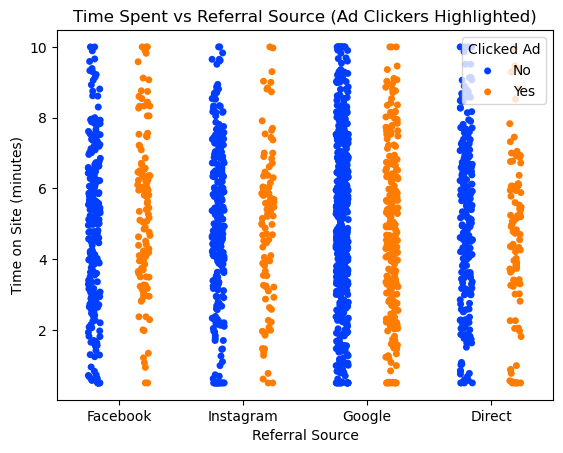

In [61]:
ax = sns.stripplot(
    data=train,
    x='Referral',
    y='Time_on_site',
    hue='Clicked_ad',
    palette='bright',
    dodge=True,)

plt.title('Time Spent vs Referral Source (Ad Clickers Highlighted)')
plt.xlabel('Referral Source')
plt.ylabel('Time on Site (minutes)')
plt.legend(
    title='Clicked Ad',
    labels=['No', 'Yes'],
    loc='upper right'
)

# Analyzing feature distribution and detecting outliers

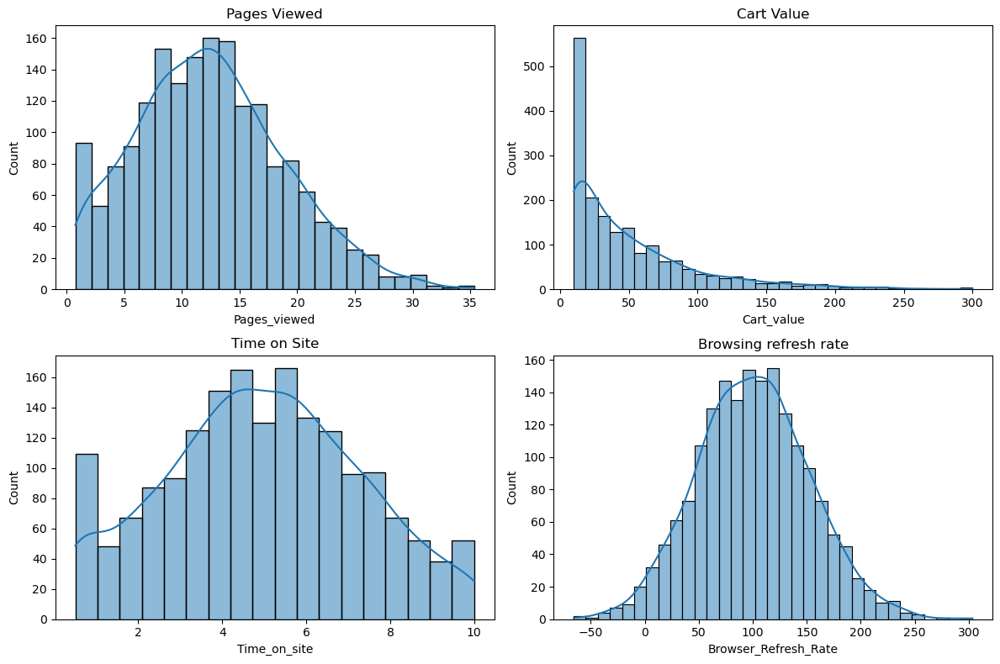

In [63]:
plt.figure(figsize=(12, 8))

plt.subplot(2, 2, 1)
sns.histplot(train['Pages_viewed'], kde=True)
plt.title("Pages Viewed")

plt.subplot(2, 2, 2)
sns.histplot(train['Cart_value'], kde=True)
plt.title("Cart Value")

plt.subplot(2, 2, 3)
sns.histplot(train['Time_on_site'], kde=True)
plt.title("Time on Site")

plt.subplot(2, 2, 4)
sns.histplot(train['Browser_Refresh_Rate'], kde=True)
plt.title("Browsing refresh rate")

plt.tight_layout()
plt.show()

After analyzing we realize there are more outliers present in 'Pages_Viewed' & 'Cart_Value'
Since Z score technique is applied only on the properly uniformed distribution hence we can apply that  in 'Time on Site' column

In [65]:
train['Time_on_site'].skew()

0.03134079668466636

Calculating the Z-Score for Time_on_site

In [76]:
train['Time_on_site_zscore']=(train['Time_on_site']-train['Time_on_site'].mean())/train['Time_on_site'].std()

In [78]:
train.head()

,Time_on_site,Pages_viewed,Clicked_ad,Cart_value,Referral,Browser_Refresh_Rate,Last_Ad_Seen,Purchase,Time_on_site_zscore
0,2.29,5.37,1,10.00,Facebook,143.14,D,1,-1.143758
1,7.49,16.36,0,25.52,Instagram,136.66,A,1,1.081914
2,5.71,13.69,0,10.00,Google,67.13,C,0,0.320050
3,1.23,3.22,1,41.49,Google,92.12,C,0,-1.597452
4,3.55,10.72,0,21.57,Direct,70.31,B,0,-0.604460


In [79]:
print(train[train['Time_on_site_zscore']>3])

Empty DataFrame
Columns: [Time_on_site, Pages_viewed, Clicked_ad, Cart_value, Referral, Browser_Refresh_Rate, Last_Ad_Seen, Purchase, Time_on_site_zscore]
Index: []


This shows that there are no outliers present in the Time_on_site column and all the data is uniformly distributed

In [86]:
upper_limit= train['Time_on_site'].mean() + 3*train['Time_on_site'].std()
lower_limit= train['Time_on_site'].mean() - 3*train['Time_on_site'].std()
print(f"The upper limit is",upper_limit)
print(f"The lower limit is",lower_limit)

The upper limit is 11.971363137533302
The lower limit is -2.0468742486444134


Calculating the Outliers for Browser_Refresh_Rate, Cart_value,Pages_viewed

In [89]:
train['Cart_value'].skew()

1.7809413944843802

In [91]:
train['Browser_Refresh_Rate'].skew()

0.10453606325233696

In [93]:
train['Pages_viewed'].skew()

0.3756775873900903

In [95]:
train['Cart_value'].describe()

count    1800.000000
mean       50.352933
std        47.443390
min        10.000000
25%        13.862500
50%        34.690000
75%        67.630000
max       300.000000
Name: Cart_value, dtype: float64

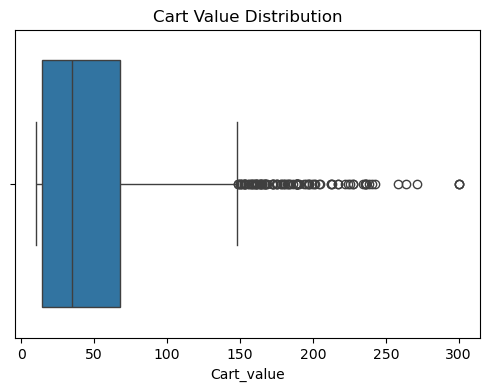

In [97]:
plt.figure(figsize=(6, 4))  
sns.boxplot(x=train['Cart_value'])
plt.title("Cart Value Distribution")
plt.show()

In [99]:
percentile25= train['Cart_value'].quantile(0.25) 
percentile75= train['Cart_value'].quantile(0.75)

In [101]:
print(f"The 75th percentile is",percentile75)
print(f"The 25th percentile is",percentile25)

The 75th percentile is 67.63
The 25th percentile is 13.8625


In [103]:
iqr = percentile75-percentile25
iqr

53.7675

In [105]:
upper_limit = percentile75 + 1.5*iqr 
lower_limit= percentile25 -1.5* iqr 
print("Upper limit", upper_limit) 
print("Lower limit", lower_limit)

Upper limit 148.28125
Lower limit -66.78875000000001


In [107]:
train[train['Cart_value']>upper_limit]

,Time_on_site,Pages_viewed,Clicked_ad,Cart_value,Referral,Browser_Refresh_Rate,Last_Ad_Seen,Purchase,Time_on_site_zscore
7,3.93,8.07,0,258.00,Instagram,126.35,C,0,-0.441815
35,4.57,15.68,0,148.62,Google,113.02,C,0,-0.167886
38,2.80,8.28,0,172.62,Google,126.38,D,0,-0.925471
60,3.07,9.01,0,166.11,Direct,108.25,D,1,-0.809907
103,10.00,31.56,0,235.60,Google,157.22,A,1,2.156229
...,...,...,...,...,...,...,...,...,...
1716,4.50,10.41,0,159.42,Google,69.12,C,0,-0.197847
1739,6.72,13.89,1,204.79,Direct,56.07,C,1,0.752344
1740,8.54,21.43,1,182.60,Facebook,133.27,B,0,1.531329
1759,4.05,14.08,0,188.79,Direct,37.41,C,0,-0.390453


Applying trimming over these 95 samples that became the outlier

In [110]:
new_df = train[train['Cart_value']<upper_limit]

In [112]:
new_df.shape

(1705, 9)

Comparing the data before and after removing the outliers

Note that some values might still be there as outliers in this case because Boxplots always recalculate outliers based on the current data’s quartiles and IQR. Trimming removes extremes, but new statistical outliers can appear in the trimmed data

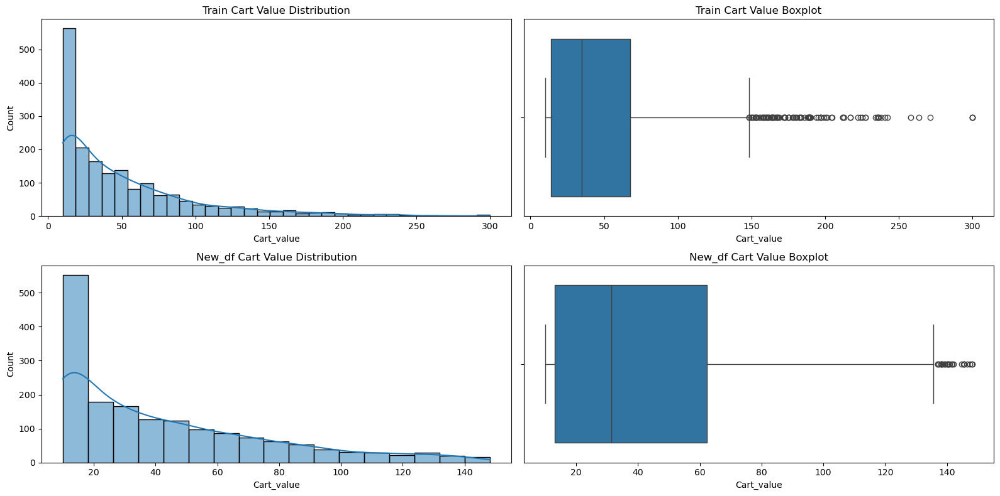

In [115]:
plt.figure(figsize=(16,8))

plt.subplot(2,2,1)
sns.histplot(train['Cart_value'], kde=True)
plt.title('Train Cart Value Distribution')

plt.subplot(2,2,2)
sns.boxplot(x=train['Cart_value'])
plt.title('Train Cart Value Boxplot')

plt.subplot(2,2,3)
sns.histplot(new_df['Cart_value'], kde=True)
plt.title('New_df Cart Value Distribution')

plt.subplot(2,2,4)
sns.boxplot(x=new_df['Cart_value'])
plt.title('New_df Cart Value Boxplot')

plt.tight_layout()
plt.show()


If we perform Capping we will perform a different procedure ensuring that no data is lost but still some data value for sure will be manipulated 

In [117]:
new_df_cap = train.copy() 
new_df_cap['Cart_value'] = np.where( 
new_df_cap['Cart_value'] > upper_limit, 
upper_limit, 
np.where( 
new_df_cap['Cart_value'] < lower_limit, 
lower_limit, 
new_df_cap['Cart_value'] 
) 
)

In [118]:
new_df_cap.shape

(1800, 9)

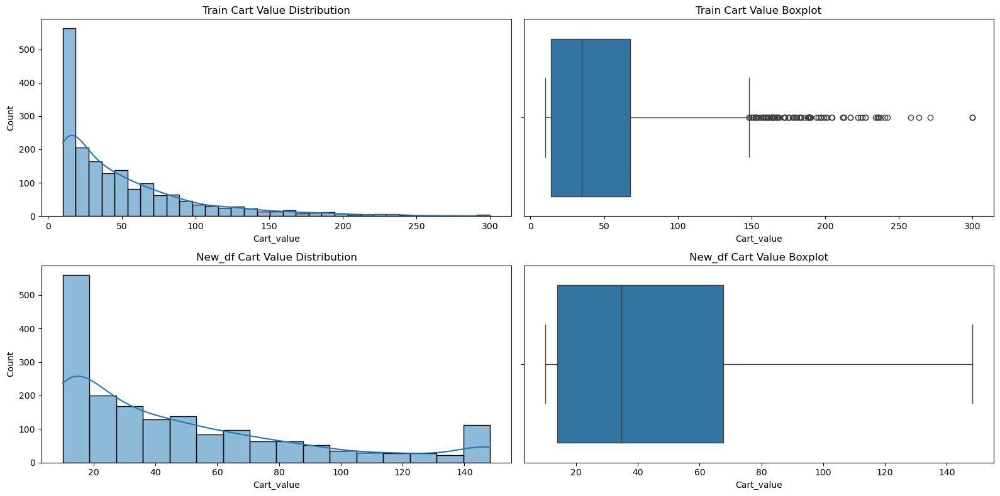

In [122]:
plt.figure(figsize=(16,8))

plt.subplot(2,2,1)
sns.histplot(train['Cart_value'], kde=True)
plt.title('Train Cart Value Distribution')

plt.subplot(2,2,2)
sns.boxplot(x=train['Cart_value'])
plt.title('Train Cart Value Boxplot')

plt.subplot(2,2,3)
sns.histplot(new_df_cap['Cart_value'], kde=True)
plt.title('New_df Cart Value Distribution')

plt.subplot(2,2,4)
sns.boxplot(x=new_df_cap['Cart_value'])
plt.title('New_df Cart Value Boxplot')

plt.tight_layout()
plt.show()

In [123]:
new_df_cap['Time_on_site'].skew()

0.03134079668466636

In [124]:
new_df_cap['Pages_viewed'].describe()

count    1800.000000
mean       12.429483
std         6.381941
min         0.760000
25%         7.860000
50%        12.020000
75%        16.500000
max        35.340000
Name: Pages_viewed, dtype: float64

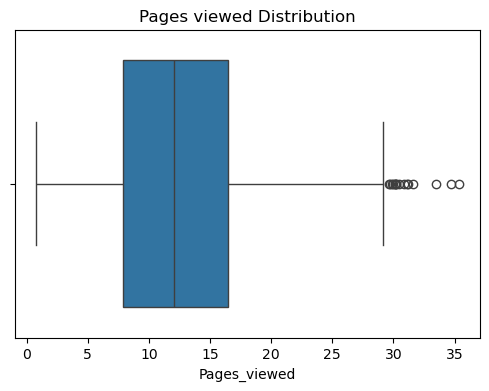

In [125]:
plt.figure(figsize=(6, 4))  
sns.boxplot(x=new_df_cap['Pages_viewed'])
plt.title("Pages viewed Distribution")
plt.show()

In [126]:
percentile25= new_df_cap['Pages_viewed'].quantile(0.25) 
percentile75= new_df_cap['Pages_viewed'].quantile(0.75)
print(f"The 75th percentile is",percentile75)
print(f"The 25th percentile is",percentile25)

The 75th percentile is 16.5
The 25th percentile is 7.86


In [130]:
iqr = percentile75-percentile25
iqr

8.64

In [133]:
upper_limit = percentile75 + 1.5*iqr 
lower_limit= percentile25 -1.5* iqr 
print("Upper limit", upper_limit) 
print("Lower limit", lower_limit)

Upper limit 29.46
Lower limit -5.1000000000000005


In [136]:
new_df_cap[new_df_cap['Pages_viewed']>upper_limit]

,Time_on_site,Pages_viewed,Clicked_ad,Cart_value,Referral,Browser_Refresh_Rate,Last_Ad_Seen,Purchase,Time_on_site_zscore
49,10.00,29.72,0,37.95000,Google,116.11,C,1,2.156229
103,10.00,31.56,0,148.28125,Google,157.22,A,1,2.156229
137,9.51,30.18,0,85.59000,Direct,131.48,D,0,1.946502
202,10.00,30.48,0,10.00000,Google,151.41,A,0,2.156229
488,10.00,30.15,1,10.00000,Google,219.78,D,0,2.156229
709,9.86,30.12,0,10.00000,Direct,125.39,D,0,2.096307
725,9.62,35.34,0,10.00000,Instagram,138.44,A,0,1.993584
1108,8.81,29.66,1,45.62000,Direct,24.33,A,1,1.646893
1150,9.07,31.11,0,24.17000,Google,95.36,A,1,1.758176
1151,10.00,33.49,0,35.77000,Facebook,164.29,C,1,2.156229


Applying trimming over these 16 samples that became the outlier

In [139]:
new_df1 = new_df_cap[new_df_cap['Pages_viewed']<upper_limit]
new_df1.shape

(1784, 9)

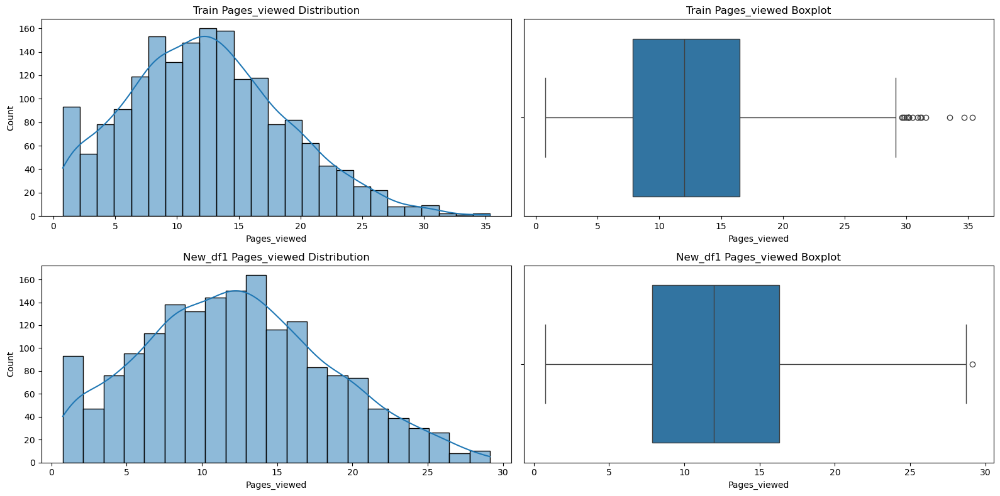

In [141]:
plt.figure(figsize=(16,8))

plt.subplot(2,2,1)
sns.histplot(new_df_cap['Pages_viewed'], kde=True)
plt.title('Train Pages_viewed Distribution')

plt.subplot(2,2,2)
sns.boxplot(x=new_df_cap['Pages_viewed'])
plt.title('Train Pages_viewed Boxplot')

plt.subplot(2,2,3)
sns.histplot(new_df1['Pages_viewed'], kde=True)
plt.title('New_df1 Pages_viewed Distribution')

plt.subplot(2,2,4)
sns.boxplot(x=new_df1['Pages_viewed'])
plt.title('New_df1 Pages_viewed Boxplot')

plt.tight_layout()
plt.show()

In [142]:
df2 = new_df_cap.copy() 
df2['Pages_viewed'] = np.where( 
df2['Pages_viewed'] > upper_limit, 
upper_limit, 
np.where( 
df2['Pages_viewed'] < lower_limit, 
lower_limit, 
df2['Pages_viewed'] 
) 
)

In [143]:
df2.shape

(1800, 9)

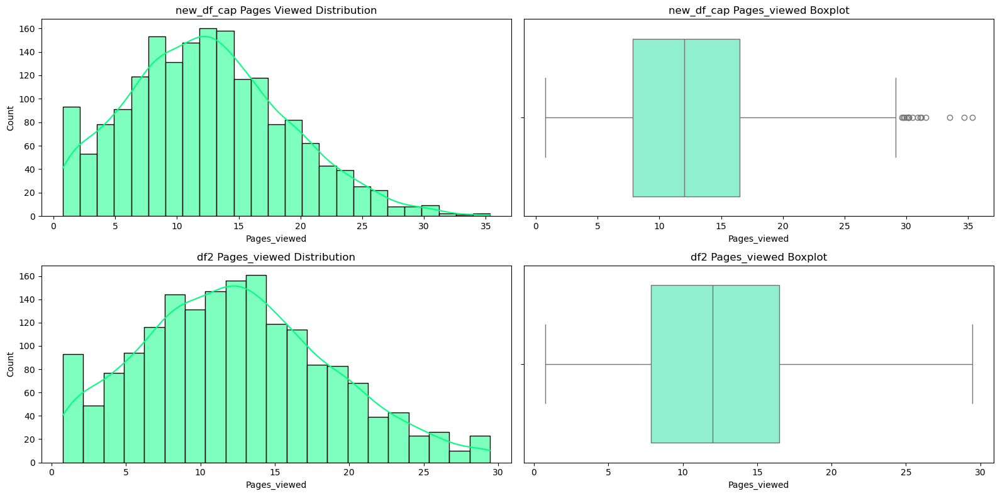

In [144]:
plt.figure(figsize=(16,8))

plt.subplot(2, 2, 1)
sns.histplot(new_df_cap['Pages_viewed'], kde=True, color='springgreen')
plt.title('new_df_cap Pages Viewed Distribution')

plt.subplot(2, 2, 2)
sns.boxplot(x=new_df_cap['Pages_viewed'], color='aquamarine')
plt.title('new_df_cap Pages_viewed Boxplot')

plt.subplot(2, 2, 3)
sns.histplot(df2['Pages_viewed'], kde=True, color='springgreen')
plt.title('df2 Pages_viewed Distribution')

plt.subplot(2, 2, 4)
sns.boxplot(x=df2['Pages_viewed'], color='aquamarine')
plt.title('df2 Pages_viewed Boxplot')

plt.tight_layout()
plt.show()

Applying Capping to Browsing Refresh Rate Column

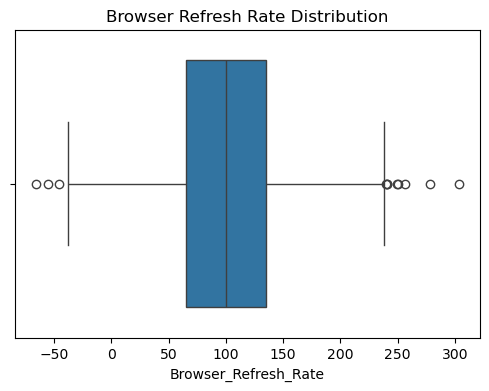

In [150]:
plt.figure(figsize=(6, 4))  
sns.boxplot(x=df2['Browser_Refresh_Rate'])
plt.title("Browser Refresh Rate Distribution")
plt.show()

In [151]:
percentile25= df2['Browser_Refresh_Rate'].quantile(0.25) 
percentile75= df2['Browser_Refresh_Rate'].quantile(0.75)
print(f"The 75th percentile is",percentile75)
print(f"The 25th percentile is",percentile25)

The 75th percentile is 134.755
The 25th percentile is 65.43


In [154]:
iqr = percentile75-percentile25
iqr

69.32499999999999

In [156]:
upper_limit = percentile75 + 1.5*iqr 
lower_limit= percentile25 -1.5* iqr 
print("Upper limit", upper_limit) 
print("Lower limit", lower_limit)

Upper limit 238.74249999999998
Lower limit -38.557499999999976


In [158]:
df = df2.copy() 
df['Browser_Refresh_Rate'] = np.where( 
df['Browser_Refresh_Rate'] > upper_limit, 
upper_limit, 
np.where( 
df['Browser_Refresh_Rate'] < lower_limit, 
lower_limit, 
df['Browser_Refresh_Rate'] 
) 
)

In [160]:
df.shape

(1800, 9)

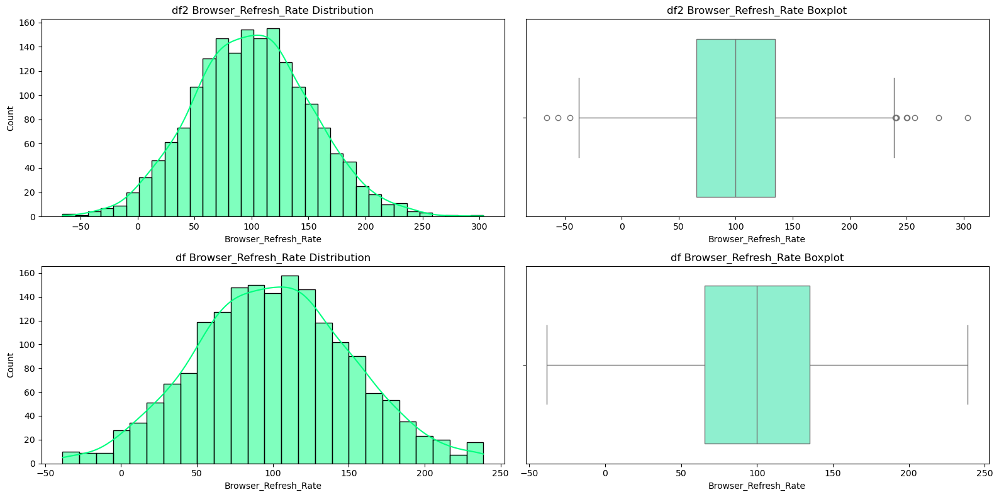

In [162]:
plt.figure(figsize=(16,8))

plt.subplot(2, 2, 1)
sns.histplot(df2['Browser_Refresh_Rate'], kde=True, color='springgreen')
plt.title('df2 Browser_Refresh_Rate Distribution')

plt.subplot(2, 2, 2)
sns.boxplot(x=df2['Browser_Refresh_Rate'], color='aquamarine')
plt.title('df2 Browser_Refresh_Rate Boxplot')

plt.subplot(2, 2, 3)
sns.histplot(df['Browser_Refresh_Rate'], kde=True, color='springgreen')
plt.title('df Browser_Refresh_Rate Distribution')

plt.subplot(2, 2, 4)
sns.boxplot(x=df['Browser_Refresh_Rate'], color='aquamarine')
plt.title('df Browser_Refresh_Rate Boxplot')

plt.tight_layout()
plt.show()

In [163]:
df.head()

,Time_on_site,Pages_viewed,Clicked_ad,Cart_value,Referral,Browser_Refresh_Rate,Last_Ad_Seen,Purchase,Time_on_site_zscore
0,2.29,5.37,1,10.00,Facebook,143.14,D,1,-1.143758
1,7.49,16.36,0,25.52,Instagram,136.66,A,1,1.081914
2,5.71,13.69,0,10.00,Google,67.13,C,0,0.320050
3,1.23,3.22,1,41.49,Google,92.12,C,0,-1.597452
4,3.55,10.72,0,21.57,Direct,70.31,B,0,-0.604460


In [164]:
df = df.drop('Time_on_site_zscore', axis=1)

In [168]:
df.head()

,Time_on_site,Pages_viewed,Clicked_ad,Cart_value,Referral,Browser_Refresh_Rate,Last_Ad_Seen,Purchase
0,2.29,5.37,1,10.00,Facebook,143.14,D,1
1,7.49,16.36,0,25.52,Instagram,136.66,A,1
2,5.71,13.69,0,10.00,Google,67.13,C,0
3,1.23,3.22,1,41.49,Google,92.12,C,0
4,3.55,10.72,0,21.57,Direct,70.31,B,0


# Model Seletion and Explanation

## Logistic Regression

<a name="2.3"></a>
### Sigmoid function
For logistic regression, the model is represented as
$$ f_{\mathbf{w},b}(x) = g(\mathbf{w}\cdot \mathbf{x} + b)$$
where function $g$ is the sigmoid function. The sigmoid function is defined as:
$$g(z) = \frac{1}{1+e^{-z}}$$
<a name='ex-01'></a>
The `sigmoid` function to calculate
$$g(z) = \frac{1}{1+e^{-z}}$$
Note that 
- `z` is not always a single number, but can also be an array of numbers. 
- If the input is an array of numbers, we'd like to apply the sigmoid function to each value in the input array.
- When you are finished, try testing a few values by calling `sigmoid(x)` in the cell below. 
- For large positive values of x, the sigmoid should be close to 1, while for large negative values, the sigmoid should be close to 0. 
- Evaluating `sigmoid(0)` should give you exactly 0.5. 

<a name="2.4"></a>
### Cost function for logistic regression
The cost function for logistic regression.
<a name='ex-02'></a>
The `compute_cost` function using the equations below.
Recall that for logistic regression, the cost function is of the form 
$$ J(\mathbf{w},b) = \frac{1}{m}\sum_{i=0}^{m-1} \left[ loss(f_{\mathbf{w},b}(\mathbf{x}^{(i)}), y^{(i)}) \right] \tag{1}$$
where
* m is the number of training examples in the dataset
* $loss(f_{\mathbf{w},b}(\mathbf{x}^{(i)}), y^{(i)})$ is the cost for a single data point, which is - 
    $$loss(f_{\mathbf{w},b}(\mathbf{x}^{(i)}), y^{(i)}) = (-y^{(i)} \log\left(f_{\mathbf{w},b}\left( \mathbf{x}^{(i)} \right) \right) - \left( 1 - y^{(i)}\right) \log \left( 1 - f_{\mathbf{w},b}\left( \mathbf{x}^{(i)} \right) \right) \tag{2}$$    
*  $f_{\mathbf{w},b}(\mathbf{x}^{(i)})$ is the model's prediction, while $y^{(i)}$, which is the actual label
*  $f_{\mathbf{w},b}(\mathbf{x}^{(i)}) = g(\mathbf{w} \cdot \mathbf{x^{(i)}} + b)$ where function $g$ is the sigmoid function.
    * It might be helpful to first calculate an intermediate variable $z_{\mathbf{w},b}(\mathbf{x}^{(i)}) = \mathbf{w} \cdot \mathbf{x^{(i)}} + b = w_0x^{(i)}_0 + ... + w_{n-1}x^{(i)}_{n-1} + b$ where $n$ is the number of features, before calculating $f_{\mathbf{w},b}(\mathbf{x}^{(i)}) = g(z_{\mathbf{w},b}(\mathbf{x}^{(i)}))$

Note:
* As you are doing this, remember that the variables `X_train` and `y_train` are not scalar values but matrices of shape ($m, n$) and ($𝑚$,1) respectively, where  $𝑛$ is the number of features and $𝑚$ is the number of training examples.
* You can use the sigmoid function that you implemented above for this part.

<a name="2.5"></a>
### Gradient for logistic regression
Now implementing the gradient for logistic regression.
Recall that the gradient descent algorithm is:
$$\begin{align*}& \text{repeat until convergence:} \; \lbrace \newline \; & b := b -  \alpha \frac{\partial J(\mathbf{w},b)}{\partial b} \newline       \; & w_j := w_j -  \alpha \frac{\partial J(\mathbf{w},b)}{\partial w_j} \tag{1}  \; & \text{for j := 0..n-1}\newline & \rbrace\end{align*}$$
where, parameters $b$, $w_j$ are all updated simultaniously

<a name="2.6"></a>
### Learning parameters using gradient descent 
Finding the optimal parameters of a logistic regression model by using gradient descent. 
- You don't need to implement anything for this part. Simply run the cells below. 
- A good way to verify that gradient descent is working correctly is to look
at the value of $J(\mathbf{w},b)$ and check that it is decreasing with each step. 
- Assuming you have implemented the gradient and computed the cost correctly, your value of $J(\mathbf{w},b)$ should never increase, and should converge to a steady value by the end of the algorithm.

## Regularized Logistic Regression
In this part, you will implement the cost function for regularized logistic regression.
Recall that for regularized logistic regression, the cost function is of the form
$$J(\mathbf{w},b) = \frac{1}{m}  \sum_{i=0}^{m-1} \left[ -y^{(i)} \log\left(f_{\mathbf{w},b}\left( \mathbf{x}^{(i)} \right) \right) - \left( 1 - y^{(i)}\right) \log \left( 1 - f_{\mathbf{w},b}\left( \mathbf{x}^{(i)} \right) \right) \right] + \frac{\lambda}{2m}  \sum_{j=0}^{n-1} w_j^2$$
Compare this to the cost function without regularization (which you implemented above), which is of the form 
$$ J(\mathbf{w}.b) = \frac{1}{m}\sum_{i=0}^{m-1} \left[ (-y^{(i)} \log\left(f_{\mathbf{w},b}\left( \mathbf{x}^{(i)} \right) \right) - \left( 1 - y^{(i)}\right) \log \left( 1 - f_{\mathbf{w},b}\left( \mathbf{x}^{(i)} \right) \right)\right]$$
The difference is the regularization term, which is $$\frac{\lambda}{2m}  \sum_{j=0}^{n-1} w_j^2$$ 
Note that the $b$ parameter is not regularized.

<a name='ex-05'></a>
The `compute_cost_reg` function below to calculate the following term for each element in $w$ 
$$\frac{\lambda}{2m}  \sum_{j=0}^{n-1} w_j^2$$
The starter code then adds this to the cost without regularization (which you computed above in `compute_cost`) to calculate the cost with regulatization.

<a name="3.5"></a>
## Gradient for regularized logistic regression
The gradient of the regularized cost function has two components. The first, $\frac{\partial J(\mathbf{w},b)}{\partial b}$ is a scalar, the other is a vector with the same shape as the parameters $\mathbf{w}$, where the $j^\mathrm{th}$ element is defined as follows:
$$\frac{\partial J(\mathbf{w},b)}{\partial b} = \frac{1}{m}  \sum_{i=0}^{m-1} (f_{\mathbf{w},b}(\mathbf{x}^{(i)}) - y^{(i)})  $$
$$\frac{\partial J(\mathbf{w},b)}{\partial w_j} = \left( \frac{1}{m}  \sum_{i=0}^{m-1} (f_{\mathbf{w},b}(\mathbf{x}^{(i)}) - y^{(i)}) x_j^{(i)} \right) + \frac{\lambda}{m} w_j  \quad\, \mbox{for $j=0...(n-1)$}$$

Compare this to the gradient of the cost function without regularization (which you implemented above), which is of the form 
$$
\frac{\partial J(\mathbf{w},b)}{\partial b}  = \frac{1}{m} \sum\limits_{i = 0}^{m-1} (f_{\mathbf{w},b}(\mathbf{x}^{(i)}) - \mathbf{y}^{(i)}) 
$$
$$
\frac{\partial J(\mathbf{w},b)}{\partial w_j}  = \frac{1}{m} \sum\limits_{i = 0}^{m-1} (f_{\mathbf{w},b}(\mathbf{x}^{(i)}) - \mathbf{y}^{(i)})x_{j}^{(i)} 
$$


As you can see,$\frac{\partial J(\mathbf{w},b)}{\partial b}$ is the same, the difference is the following term in $\frac{\partial J(\mathbf{w},b)}{\partial w}$, which is $$\frac{\lambda}{m} w_j  \quad\, \mbox{for $j=0...(n-1)$}$$ 


<a name="3.6"></a>
## Learning parameters using gradient descent
Similar to the previous parts, you will use your gradient descent function implemented above to learn the optimal parameters $w$,$b$. 
- If you have completed the cost and gradient for regularized logistic regression correctly, you should be able to step through the next cell to learn the parameters $w$. 
- After training our parameters, we will use it to plot the decision boundary. 

In [173]:
data= df.copy()

In [175]:
data.head()

,Time_on_site,Pages_viewed,Clicked_ad,Cart_value,Referral,Browser_Refresh_Rate,Last_Ad_Seen,Purchase
0,2.29,5.37,1,10.00,Facebook,143.14,D,1
1,7.49,16.36,0,25.52,Instagram,136.66,A,1
2,5.71,13.69,0,10.00,Google,67.13,C,0
3,1.23,3.22,1,41.49,Google,92.12,C,0
4,3.55,10.72,0,21.57,Direct,70.31,B,0


In [177]:
from sklearn.model_selection import train_test_split 
from sklearn.preprocessing import MinMaxScaler 
from sklearn.pipeline import Pipeline, make_pipeline 
from sklearn.feature_selection import SelectKBest,chi2 
from sklearn.linear_model import LogisticRegression

In [178]:
pd= data.drop(['Browser_Refresh_Rate'], axis=1)

In [179]:
pd.isnull().sum()

Time_on_site    0
Pages_viewed    0
Clicked_ad      0
Cart_value      0
Referral        0
Last_Ad_Seen    0
Purchase        0
dtype: int64

Since the Data contains no missing values. Hence while applying Machine Learning Pipelines we won't be using the simple imputer class that is used to completely fill empty value 

In [184]:
X_train = pd.drop('Purchase', axis=1) 
y_train = pd['Purchase']    

In [186]:
from sklearn.preprocessing import OneHotEncoder, PowerTransformer
from sklearn.compose import ColumnTransformer

categorical_features = ['Referral', 'Last_Ad_Seen']
numeric_features = ['Cart_value', 'Time_on_site', 'Pages_viewed']

trf1 = ColumnTransformer(
    transformers=[
        ('ohe', OneHotEncoder(handle_unknown='ignore', drop='first'), categorical_features),
        ('yeojohnson', PowerTransformer(method='yeo-johnson'), numeric_features)
    ],
    remainder='passthrough', 
    verbose_feature_names_out=False,
    force_int_remainder_cols=False
)

##Presence of Remainder Columns:
## As i do have columns not included in any transformer and use remainder='passthrough' (or another transformer), the transformers_ attribute will show these columns as indices (if force_int_remainder_cols=True) or as names (if False).
##If I try to access these indices as if they were names elsewhere in your code, I got errors.

In [188]:
trf2 = ColumnTransformer(
    transformers=[
        ('MinMax', MinMaxScaler(), [0, 1, 2]) 
    ],
    remainder='passthrough'
)

In [190]:
from sklearn.feature_selection import f_classif
trf3 = SelectKBest(score_func=f_classif, k=5)

## ANOVA F-test Formulae

### 1. Sum of Squares Between Groups (SSB)
Measures variance between class means and the overall mean:

$$
SSB = \sum_{k=1}^K n_k (\bar{x}_k - \bar{x})^2
$$

### 2. Sum of Squares Within Groups (SSW)
Measures variance within each class:

$$
SSW = \sum_{k=1}^K \sum_{i=1}^{n_k} (x_{i,k} - \bar{x}_k)^2
$$

### 3. Mean Squares
**Between-Group Mean Square**:
$$
MSB = \frac{SSB}{K-1}
$$

**Within-Group Mean Square**:
$$
MSW = \frac{SSW}{N-K}
$$

### 4. F-Statistic
Ratio of between-group variance to within-group variance:

$$
F = \frac{MSB}{MSW}
$$

### Variable Definitions
- $n_k$: Number of samples in class $k$
- $\bar{x}_k$: Mean of feature $x$ for class $k$  
- $\bar{x}$: Overall mean of feature $x$
- $x_{i,k}$: Value of feature $x$ for sample $i$ in class $k$
- $K$: Number of classes
- $N$: Total number of samples

High F-value: Feature means differ significantly across classes → Feature is important.

Low F-value: Feature means are similar across classes → Feature is less relevant.

In [193]:
trf4 = LogisticRegression(penalty='l2', C=1.0, max_iter=1000)

C and λ are inversely related.
C = m / λ (where m is the number of training examples).
In scikit-learn, you control regularization via C, not λ.
There is no direct “λ/2m” parameter in scikit-learn; it’s handled internally based on C.

## Creating a Machine Learning pipeline 

In [197]:
pipe = Pipeline([
    ('trf1', trf1),
    ('trf2', trf2),
    ('trf3', trf3),
    ('trf4', trf4),
])

In [199]:
pipe.fit(X_train,y_train)

Pipeline(steps=[('trf1',
                 ColumnTransformer(force_int_remainder_cols=False,
                                   remainder='passthrough',
                                   transformers=[('ohe',
                                                  OneHotEncoder(drop='first',
                                                                handle_unknown='ignore'),
                                                  ['Referral', 'Last_Ad_Seen']),
                                                 ('yeojohnson',
                                                  PowerTransformer(),
                                                  ['Cart_value', 'Time_on_site',
                                                   'Pages_viewed'])],
                                   verbose_feature_names_out=False)),
                ('trf2',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('MinMax', MinMaxScaler(),
                                                  [0, 1, 2])])),
                ('trf3', SelectKBest(k=5)),
                ('trf4', LogisticRegression(max_iter=1000))])

In [200]:
pipe.named_steps

{'trf1': ColumnTransformer(force_int_remainder_cols=False, remainder='passthrough',
                   transformers=[('ohe',
                                  OneHotEncoder(drop='first',
                                                handle_unknown='ignore'),
                                  ['Referral', 'Last_Ad_Seen']),
                                 ('yeojohnson', PowerTransformer(),
                                  ['Cart_value', 'Time_on_site',
                                   'Pages_viewed'])],
                   verbose_feature_names_out=False),
 'trf2': ColumnTransformer(remainder='passthrough',
                   transformers=[('MinMax', MinMaxScaler(), [0, 1, 2])]),
 'trf3': SelectKBest(k=5),
 'trf4': LogisticRegression(max_iter=1000)}

In [201]:
pipe.named_steps['trf4']


LogisticRegression(max_iter=1000)

class sklearn.linear_model.LogisticRegression(penalty='l2', *, dual=False, tol=0.0001, C=1.0, fit_intercept=True, intercept_scaling=1, class_weight=None, random_state=None, solver='lbfgs', max_iter=100, multi_class='deprecated', verbose=0, warm_start=False, n_jobs=None, l1_ratio=None)

In [206]:
test_set= test.drop(['Browser_Refresh_Rate'], axis=1)

In [208]:
X_test = test_set.drop('Purchase', axis=1)  

y_test = test_set['Purchase']    

In [210]:
y_pred= pipe.predict(X_test)

In [212]:
from sklearn.metrics  import accuracy_score
accuracy_score(y_test,y_pred)

0.7711111111111111

### Trying to do Feature Engineering via adding interaction features (e.g., Time_on_site * Pages_viewed)

In [215]:
pd['Time_spent'] = pd['Time_on_site'] * pd['Pages_viewed']

In [217]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer

trf1 = ColumnTransformer(
    transformers=[
        ('ohe', OneHotEncoder(handle_unknown='ignore', drop='first'), ['Referral', 'Last_Ad_Seen'])
    ],
    remainder='passthrough',
    force_int_remainder_cols=False
)

##Presence of Remainder Columns:
## As i do have columns not included in any transformer and use remainder='passthrough' (or another transformer), the transformers_ attribute will show these columns as indices (if force_int_remainder_cols=True) or as names (if False).
##If I try to access these indices as if they were names elsewhere in your code, I got errors.

In [231]:
trf1.fit(pd2, y_train)
transformed_features = trf1.get_feature_names_out()

cart_value_idx = list(transformed_features).index('remainder__Cart_value')
time_spent_idx = list(transformed_features).index('remainder__Time_spent')

trf2 = ColumnTransformer(
    transformers=[
        ('MinMax', MinMaxScaler(), [cart_value_idx, time_spent_idx])
    ],
    remainder='passthrough'
)

In [233]:
trf3 = SelectKBest(score_func=chi2, k=5)

In [235]:
trf4= LogisticRegression(penalty='l2', C=1.0, max_iter=100)

In [237]:
pd2=pd.drop(['Time_on_site','Pages_viewed','Purchase'], axis=1)

In [239]:
pd2.head()

,Clicked_ad,Cart_value,Referral,Last_Ad_Seen,Time_spent
0,1,10.00,Facebook,D,12.2973
1,0,25.52,Instagram,A,122.5364
2,0,10.00,Google,C,78.1699
3,1,41.49,Google,C,3.9606
4,0,21.57,Direct,B,38.0560


In [241]:
pipe2 = Pipeline([
    ('trf1', trf1),
    ('trf2', trf2),
    ('trf3', trf3),
    ('trf4', trf4),
])

In [243]:
pipe2.fit(pd2,y_train)

Pipeline(steps=[('trf1',
                 ColumnTransformer(force_int_remainder_cols=False,
                                   remainder='passthrough',
                                   transformers=[('ohe',
                                                  OneHotEncoder(drop='first',
                                                                handle_unknown='ignore'),
                                                  ['Referral',
                                                   'Last_Ad_Seen'])])),
                ('trf2',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('MinMax', MinMaxScaler(),
                                                  [7, 8])])),
                ('trf3',
                 SelectKBest(k=5,
                             score_func=<function chi2 at 0x0000026140192A20>)),
                ('trf4', LogisticRegression())])

In [244]:
pipe2.named_steps

{'trf1': ColumnTransformer(force_int_remainder_cols=False, remainder='passthrough',
                   transformers=[('ohe',
                                  OneHotEncoder(drop='first',
                                                handle_unknown='ignore'),
                                  ['Referral', 'Last_Ad_Seen'])]),
 'trf2': ColumnTransformer(remainder='passthrough',
                   transformers=[('MinMax', MinMaxScaler(), [7, 8])]),
 'trf3': SelectKBest(k=5, score_func=<function chi2 at 0x0000026140192A20>),
 'trf4': LogisticRegression()}

In [247]:
test_set2= test.copy()

In [249]:
test_set2['Time_spent'] = test['Time_on_site'] * test['Pages_viewed']

In [251]:
test_set2= test_set2.drop(['Browser_Refresh_Rate','Time_on_site','Pages_viewed'], axis=1)

In [253]:
test_set2.head()

,Clicked_ad,Cart_value,Referral,Last_Ad_Seen,Purchase,Time_spent
0,0,27.66,Google,C,0,42.4908
1,0,15.05,Direct,C,0,38.2500
2,0,105.27,Facebook,A,1,107.4200
3,1,21.17,Direct,D,0,126.3456
4,0,91.31,Instagram,B,1,256.3442


In [255]:
X_test2 = test_set2.drop('Purchase', axis=1)  

y_test2 = test_set2['Purchase']

In [257]:
y_pred2= pipe2.predict(X_test2)

In [259]:
from sklearn.metrics  import accuracy_score
accuracy_score(y_test2,y_pred2)

0.7822222222222223

### Realised that It was not of much use as both the columns were of nearly the same importance and hence the pipeline 1&2 both are equally performing. 

### You can indeed see that though they are not representing the same outputs but still their performance remains of nearly the same level

In [262]:
y_pred2

array([0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0,
       0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1,
       0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0,
       1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0,

In [263]:
y_pred

array([0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1,
       0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0,

#### APPLYING CROSS VALIDATION USING PIPELINE ON OUR BOTH PIPELINES

In scikit-learn, cross-validation is the process of splitting your dataset into multiple “folds” in order to:

Train your model on a subset of the data

Validate it on the held-out fold

Repeat this process across all folds

Aggregate the evaluation scores to get a more reliable estimate of generalization performance

#### Pipeline 1

In [268]:
from sklearn.model_selection import cross_val_score
cross_val_score(pipe,X_train,y_train,cv=5,scoring='accuracy').mean()

0.7511111111111111

#### Pipeline 2


In [271]:
from sklearn.model_selection import cross_val_score
cross_val_score(pipe2,pd2,y_train,cv=20,scoring='accuracy').mean()

0.7549999999999999

## F1 Score, Recall , Precision, Accuracy:

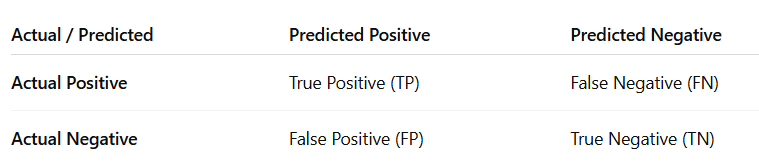

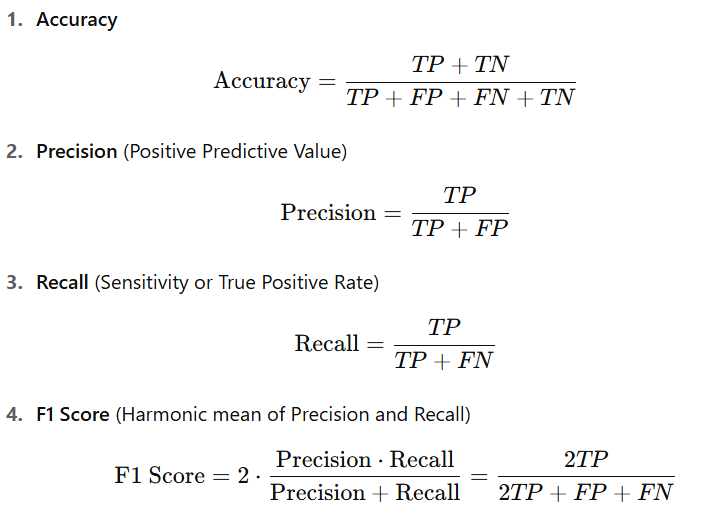

THERE ARE TWO TYPES OF ERRORS :

TYPE 1: THESE ARE THE ERRORS THAT ARE CALCULATED BY FALSE POSITIVE

TYPE 2: THESE ARE THE ERRORS THAT ARE CALCULATED BY FALSE NEGATIVE

Confusion matrix for Pipeline 1: 

In [278]:
from sklearn.metrics import accuracy_score,confusion_matrix
confusion_matrix(y_test,y_pred)

array([[280,  34],
       [ 69,  67]], dtype=int64)

Confusion matrix for Pipeline 2: 

In [281]:
from sklearn.metrics import accuracy_score,confusion_matrix
confusion_matrix(y_test,y_pred2)

array([[282,  32],
       [ 66,  70]], dtype=int64)

In [283]:
from sklearn.metrics import recall_score,precision_score,f1_score

In [285]:
print("For Logistic regression Model 1") 
print("Precision - ", precision_score(y_test,y_pred)) 
print("Recall -", recall_score(y_test,y_pred)) 
print("F1 score- ", f1_score(y_test,y_pred))

For Logistic regression Model 1
Precision -  0.6633663366336634
Recall - 0.49264705882352944
F1 score-  0.5654008438818565


In [287]:
print("For Logistic regression Model 2") 
print("Precision - ", precision_score(y_test,y_pred2)) 
print("Recall -", recall_score(y_test,y_pred2)) 
print("F1 score- ", f1_score(y_test,y_pred2))

For Logistic regression Model 2
Precision -  0.6862745098039216
Recall - 0.5147058823529411
F1 score-  0.5882352941176471


## Grid and Random Search

### APPLYING SAGA (Stochastic Average Gradient Accelerated): Optimization Algorithm

#### What is l1_ratio?

##### l1_ratio is a hyperparameter in ElasticNet regularization that controls the mix between L1 (Lasso) and L2 (Ridge) penalties.
##### l1_ratio = 1: Pure L1 regularization (Lasso).
##### l1_ratio = 0: Pure L2 regularization (Ridge).
##### 0 < l1_ratio < 1: A blend of L1 and L2 penalties. Example: If l1_ratio = 0.7, the penalty is 0.7 * L1 + 0.3 * L2.


##### In the first part of param_grid for L1/L2 (no l1_ratio needed)


##### The l1 ratio is required specifically while evaluating the ElasticNet

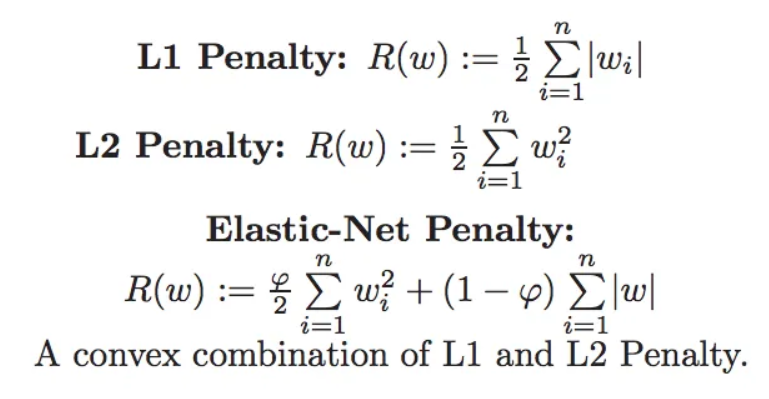

##### ϕ(phi): Overall regularization strength (controlled by C = 1/ϕ in scikit-learn).
##### l1_ratio: Balances L1 and L2 penalties.

##### L1 (Lasso): Encourages sparsity (some coefficients become exactly zero).
##### L2 (Ridge): Shrinks coefficients but rarely zeros them.
##### ElasticNet: Combines both to handle correlated features and avoid overfitting.

In [289]:
pd3= data.drop(['Browser_Refresh_Rate'], axis=1)
Xtrain = pd3.drop('Purchase', axis=1)  
ytrain = pd3['Purchase'] 

In [251]:
trf_1 = ColumnTransformer(
    transformers=[
        ('ohe', OneHotEncoder(handle_unknown='ignore', drop='first'), ['Referral', 'Last_Ad_Seen'])
    ],
    remainder='passthrough',
    force_int_remainder_cols=False
)


trf_1.fit(X_train)
transformed_features = trf_1.get_feature_names_out()

cart_idx = list(transformed_features).index('remainder__Cart_value')
time_idx = list(transformed_features).index('remainder__Pages_viewed')
time_idx2 = list(transformed_features).index('remainder__Time_on_site')

trf_2 = ColumnTransformer(
    transformers=[
        ('MinMax', MinMaxScaler(), [cart_idx, time_idx,time_idx2 ]) 
    ],
    remainder='passthrough'
)
trf_3 = SelectKBest(score_func=chi2, k=7)
trf_4= LogisticRegression(solver='saga', max_iter=1000)

pipe3 = Pipeline([
    ('trf_1', trf_1),
    ('trf_2', trf_2),
    ('trf_3', trf_3),
    ('trf_4', trf_4),
])

param_grid = [
    {
        'trf_4__penalty': ['l1', 'l2'],
        'trf_4__C': [0.001, 0.01, 0.1, 1, 10, 100]
    },
    {
        'trf_4__penalty': ['elasticnet'],
        'trf_4__C': [0.001, 0.01, 0.1, 1, 10, 100],
        'trf_4__l1_ratio': [0.3, 0.5, 0.7] 
    }
]

In [253]:
from sklearn.model_selection import GridSearchCV

grid_search = GridSearchCV(
    estimator=pipe3,
    param_grid=param_grid,
    scoring='accuracy',
    cv=5,  
    n_jobs=-1  
)
grid_search.fit(Xtrain, ytrain)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('trf_1',
                                        ColumnTransformer(force_int_remainder_cols=False,
                                                          remainder='passthrough',
                                                          transformers=[('ohe',
                                                                         OneHotEncoder(drop='first',
                                                                                       handle_unknown='ignore'),
                                                                         ['Referral',
                                                                          'Last_Ad_Seen'])])),
                                       ('trf_2',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('MinMax',
                                                                         MinMaxScaler(),
                                                                         [9, 7,
                                                                          6])])),
                                       ('trf_3',
                                        SelectKBest(k=7,
                                                    score_func=<function chi2 at 0x000001F965C293A0>)),
                                       ('trf_4',
                                        LogisticRegression(max_iter=1000,
                                                           solver='saga'))]),
             n_jobs=-1,
             param_grid=[{'trf_4__C': [0.001, 0.01, 0.1, 1, 10, 100],
                          'trf_4__penalty': ['l1', 'l2']},
                         {'trf_4__C': [0.001, 0.01, 0.1, 1, 10, 100],
                          'trf_4__l1_ratio': [0.3, 0.5, 0.7],
                          'trf_4__penalty': ['elasticnet']}],
             scoring='accuracy')

In [254]:
print("Best Parameters:", grid_search.best_params_)

Best Parameters: {'trf_4__C': 1, 'trf_4__l1_ratio': 0.5, 'trf_4__penalty': 'elasticnet'}


In [291]:
X_test2 = test_set.drop('Purchase', axis=1)  
y_test2 = test_set['Purchase']    

In [256]:
test_accuracy = grid_search.score(X_test2, y_test2)
print("Test Accuracy:", test_accuracy)

Test Accuracy: 0.7822222222222223


# Random Forest Algorithm

<a name="4"></a>
## Decision Tree Refresher

- In Decision Tree we implement the following functions, which let us to split a node into left and right branches using the feature with the highest information gain
    - We Calculate the entropy at a node 
    - Split the dataset at a node into left and right branches based on a given feature
    - Calculate the information gain from splitting on a given feature
    - Choose the feature that maximizes information gain
    - We choose the split that gives us the maximum of IGV as greater will be the purity of subsets
    
<a name="4.1"></a>
### Calculate entropy

Computing the entropy (measure of impurity) at a node. 

* The entropy is then calculated as 

$$H(p_1) = -p_1 \text{log}_2(p_1) - (1- p_1) \text{log}_2(1- p_1)$$
* Note 
    * The log is calculated with base $2$
    * For implementation purposes, $0\text{log}_2(0) = 0$. That is, if `p_1 = 0` or `p_1 = 1`, set the entropy to `0`
    
<a name="ex01"></a>

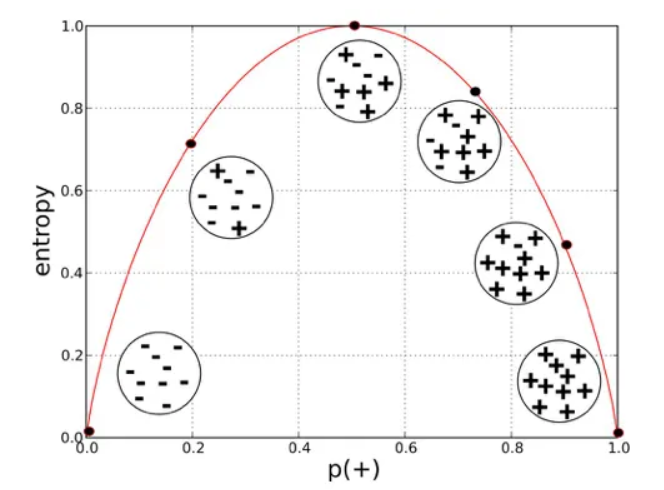

<a name="4.3"></a>
### Calculating information gain

It takes in the training data, the indices at a node and a feature to split on and returns the information gain from the split.

$$\text{Information Gain} = H(p_1^\text{node})- (w^{\text{left}}H(p_1^\text{left}) + w^{\text{right}}H(p_1^\text{right}))$$

where 
- $H(p_1^\text{node})$ is entropy at the node 
- $H(p_1^\text{left})$ and $H(p_1^\text{right})$ are the entropies at the left and the right branches resulting from the split
- $w^{\text{left}}$ and $w^{\text{right}}$ are the proportion of examples at the left and right branch, respectively

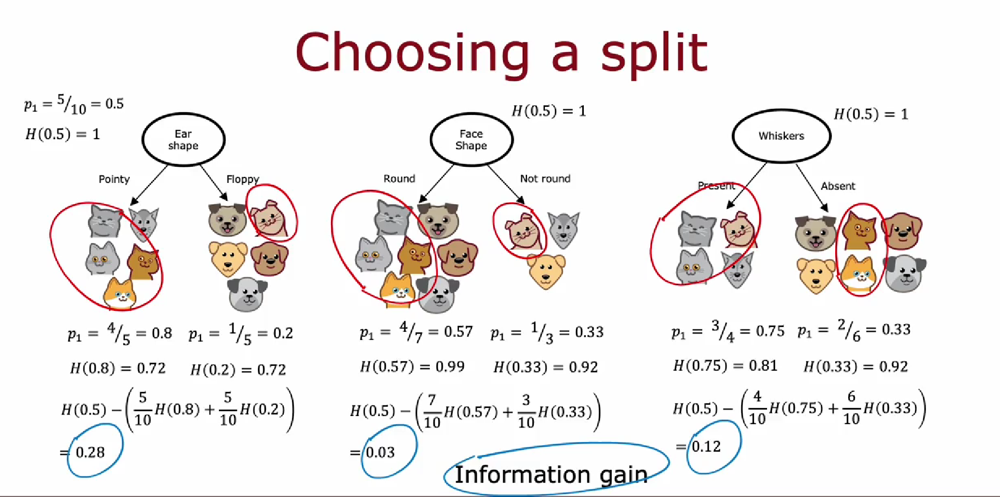

Random Forest is a powerful ensemble machine learning algorithm that combines multiple decision trees to create a robust and accurate predictive model.It merges their predictions to produce a final result that is more accurate and stable than any individual tree. The "forest" consists of numerous decision trees, each trained on a different random subset of the training data using a technique called bootstrap aggregating or "bagging"

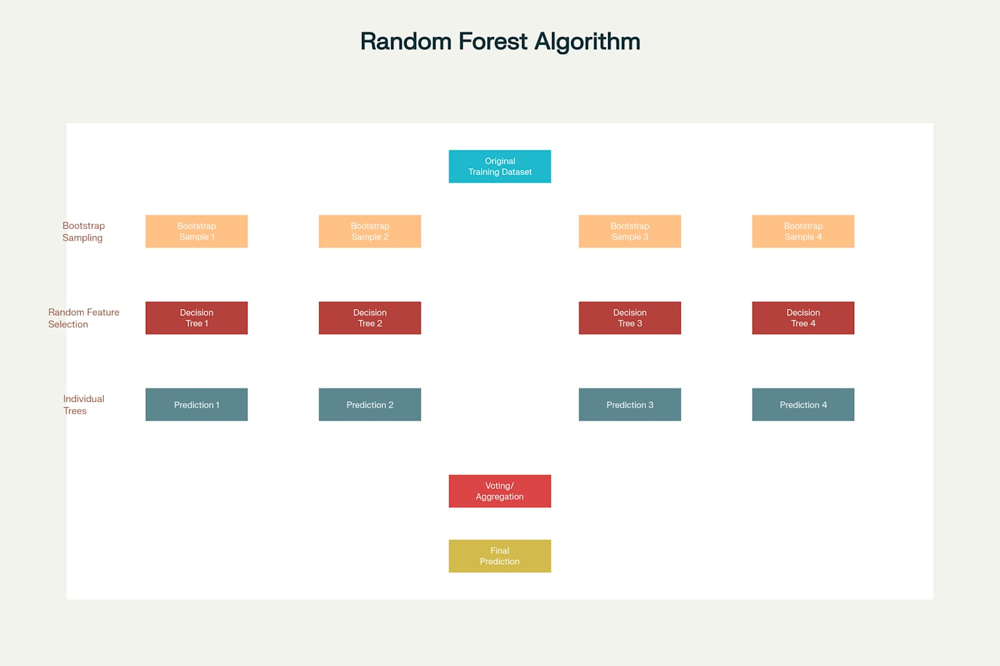

### Random Forest uses the Gini impurity criterion to determine the best splits at each node in the decision trees . 

The **Gini impurity** for a node is calculated as:

$$
\text{Gini} = 1 - \sum_{i=1}^C p_i^2
$$

where:
- **$C$**: Number of classes (e.g., Purchase: Yes/No).
- **$p_i$**: Proportion of class $i$ in the node.


The Gini Impurity reduction ($\Delta$Gini) after a split is calculated as:

$$
\Delta\text{Gini} = \text{Gini}_{\text{parent}} - \left( \frac{N_{\text{left}}}{N_{\text{parent}}} \text{Gini}_{\text{left}} + \frac{N_{\text{right}}}{N_{\text{parent}}} \text{Gini}_{\text{right}} \right)
$$

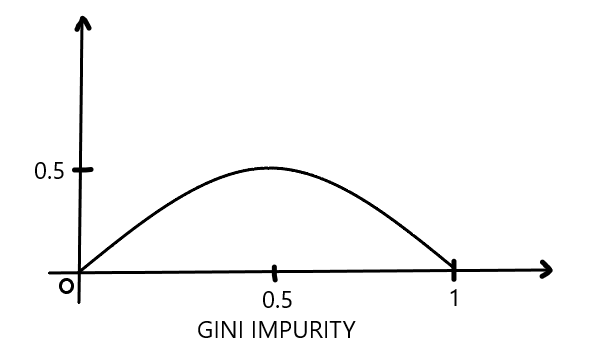

In [293]:
data2=df.copy()

In [295]:
data2.head()

,Time_on_site,Pages_viewed,Clicked_ad,Cart_value,Referral,Browser_Refresh_Rate,Last_Ad_Seen,Purchase
0,2.29,5.37,1,10.00,Facebook,143.14,D,1
1,7.49,16.36,0,25.52,Instagram,136.66,A,1
2,5.71,13.69,0,10.00,Google,67.13,C,0
3,1.23,3.22,1,41.49,Google,92.12,C,0
4,3.55,10.72,0,21.57,Direct,70.31,B,0


In [297]:
X = data2.drop('Purchase', axis=1)
y = data2['Purchase']

In [299]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import OneHotEncoder, StandardScaler

In [301]:
cat_feats = ['Referral','Last_Ad_Seen']
num_feats = ['Cart_value','Time_on_site','Pages_viewed','Browser_Refresh_Rate']

preprocessor = ColumnTransformer([
    ('num_pt_mm',
     Pipeline([
         ('yeo', PowerTransformer(method='yeo-johnson')),
         ('mm',  MinMaxScaler())
     ]),
     num_feats),
    ('cat_ohe',
     OneHotEncoder(handle_unknown='ignore', drop='first'),
     cat_feats),
], remainder='drop')

In [303]:
pipe4 = Pipeline([
    ('pre', preprocessor),
    ('sel', SelectKBest(f_classif, k=5)),
    ('rf',  RandomForestClassifier(n_estimators=100,
                                   min_samples_split=5,
                                   random_state=42,
                                   n_jobs=-1))
])

pipe4.named_steps



{'pre': ColumnTransformer(transformers=[('num_pt_mm',
                                  Pipeline(steps=[('yeo', PowerTransformer()),
                                                  ('mm', MinMaxScaler())]),
                                  ['Cart_value', 'Time_on_site', 'Pages_viewed',
                                   'Browser_Refresh_Rate']),
                                 ('cat_ohe',
                                  OneHotEncoder(drop='first',
                                                handle_unknown='ignore'),
                                  ['Referral', 'Last_Ad_Seen'])]),
 'sel': SelectKBest(k=5),
 'rf': RandomForestClassifier(min_samples_split=5, n_jobs=-1, random_state=42)}

In [305]:
pipe4.fit(X, y)

Pipeline(steps=[('pre',
                 ColumnTransformer(transformers=[('num_pt_mm',
                                                  Pipeline(steps=[('yeo',
                                                                   PowerTransformer()),
                                                                  ('mm',
                                                                   MinMaxScaler())]),
                                                  ['Cart_value', 'Time_on_site',
                                                   'Pages_viewed',
                                                   'Browser_Refresh_Rate']),
                                                 ('cat_ohe',
                                                  OneHotEncoder(drop='first',
                                                                handle_unknown='ignore'),
                                                  ['Referral',
                                                   'Last_Ad_Seen'])])),
                ('sel', SelectKBest(k=5)),
                ('rf',
                 RandomForestClassifier(min_samples_split=5, n_jobs=-1,
                                        random_state=42))])

In [307]:
y_pred3 = pipe4.predict(test)
print("Accuracy:", accuracy_score(y_test, y_pred3))

Accuracy: 0.7533333333333333


In [309]:
X1=train.copy()

In [311]:
train.head()

,Time_on_site,Pages_viewed,Clicked_ad,Cart_value,Referral,Browser_Refresh_Rate,Last_Ad_Seen,Purchase,Time_on_site_zscore
0,2.29,5.37,1,10.00,Facebook,143.14,D,1,-1.143758
1,7.49,16.36,0,25.52,Instagram,136.66,A,1,1.081914
2,5.71,13.69,0,10.00,Google,67.13,C,0,0.320050
3,1.23,3.22,1,41.49,Google,92.12,C,0,-1.597452
4,3.55,10.72,0,21.57,Direct,70.31,B,0,-0.604460


In [313]:
X2 = X1.drop('Purchase', axis=1)
Y2 = X1['Purchase']

In [315]:
X1.head()

,Time_on_site,Pages_viewed,Clicked_ad,Cart_value,Referral,Browser_Refresh_Rate,Last_Ad_Seen,Purchase,Time_on_site_zscore
0,2.29,5.37,1,10.00,Facebook,143.14,D,1,-1.143758
1,7.49,16.36,0,25.52,Instagram,136.66,A,1,1.081914
2,5.71,13.69,0,10.00,Google,67.13,C,0,0.320050
3,1.23,3.22,1,41.49,Google,92.12,C,0,-1.597452
4,3.55,10.72,0,21.57,Direct,70.31,B,0,-0.604460


In [317]:
X2 = X2.drop('Time_on_site_zscore', axis=1)

In [319]:
test.head()

,Time_on_site,Pages_viewed,Clicked_ad,Cart_value,Referral,Browser_Refresh_Rate,Last_Ad_Seen,Purchase
0,3.33,12.76,0,27.66,Google,131.60,C,0
1,3.75,10.20,0,15.05,Direct,41.63,C,0
2,6.55,16.40,0,105.27,Facebook,98.72,A,1
3,6.42,19.68,1,21.17,Direct,180.20,D,0
4,8.38,30.59,0,91.31,Instagram,58.70,B,1


In [321]:
X_test2 = test.drop('Purchase', axis=1)  
y_test2 = test['Purchase']    

In [323]:
numeric_features     = ['Cart_value', 'Time_on_site', 'Pages_viewed']  
categorical_features = ['Referral', 'Last_Ad_Seen']                    

preprocessor = ColumnTransformer([
    ('ohe', OneHotEncoder(handle_unknown='ignore', drop='first'),
     categorical_features),
], remainder='passthrough')  

rf_pipeline = Pipeline([
    ('pre', preprocessor),
    ('clf', RandomForestClassifier(n_estimators=100, random_state=42))
])


In [325]:
rf_pipeline.fit(X2,Y2)

E:\Anaconda\Lib\site-packages\sklearn\compose\_column_transformer.py:1623: FutureWarning: 
The format of the columns of the 'remainder' transformer in ColumnTransformer.transformers_ will change in version 1.7 to match the format of the other transformers.
At the moment the remainder columns are stored as indices (of type int). With the same ColumnTransformer configuration, in the future they will be stored as column names (of type str).
To use the new behavior now and suppress this warning, use ColumnTransformer(force_int_remainder_cols=False).

  warnings.warn(


Pipeline(steps=[('pre',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ohe',
                                                  OneHotEncoder(drop='first',
                                                                handle_unknown='ignore'),
                                                  ['Referral',
                                                   'Last_Ad_Seen'])])),
                ('clf', RandomForestClassifier(random_state=42))])

In [327]:
rf_pipeline.fit(X2,Y2)
y_pred4 = rf_pipeline.predict(X_test2)


In [329]:
accuracy_score(y_test,y_pred4)

0.7711111111111111

## Already explained the mathematical formulaes for this and its intuition above for calculation of F1 score , Recall, Precision and Confusion Matrix

In [568]:
precision = precision_score(y_test,y_pred4)
recall = recall_score(y_test,y_pred4)
f1 = f1_score(y_test,y_pred4)

conf_mat = confusion_matrix(y_test,y_pred4)

print(f"Precision: {precision:.2f}")
print(f"Recall:    {recall:.2f}")
print(f"F1 Score:  {f1:.2f}")
print("\nConfusion Matrix:")
print(conf_mat)

Precision: 0.63
Recall:    0.59
F1 Score:  0.61

Confusion Matrix:
[[267  47]
 [ 56  80]]


## Grid Search On Random Forest Classifier

In [400]:
categorical_features = ['Referral', 'Last_Ad_Seen']
numerical_features   = ['Cart_value', 'Time_on_site', 'Pages_viewed']

preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore', drop='first'),
         categorical_features),
        ('num', StandardScaler(), numerical_features),
    ],
    remainder='passthrough'
)

pipe = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', RandomForestClassifier(random_state=42))
])

param_grid = {
    'classifier__n_estimators':      [100, 200, 300, 400, 500],
    'classifier__max_depth':         [None, 5, 10, 15, 20],
    'classifier__max_features':      ['sqrt', 'log2', None],
    'classifier__min_samples_split': [2, 5, 10],
    'classifier__min_samples_leaf':  [1, 2, 4],
    'classifier__bootstrap':         [True, False]
}

grid_search = GridSearchCV(
    estimator=pipe,
    param_grid=param_grid,
    cv=5,
    scoring='accuracy',
    n_jobs=-1,
    verbose=2
)

grid_search.fit(X2, Y2)

print("Best Parameters:", grid_search.best_params_)
print("Best CV Accuracy:", grid_search.best_score_)

best_model     = grid_search.best_estimator_
test_accuracy  = best_model.score(X_test2, y_test2)
print("Test Accuracy:  ", test_accuracy)

Fitting 5 folds for each of 1350 candidates, totalling 6750 fits
Best Parameters: {'classifier__bootstrap': True, 'classifier__max_depth': None, 'classifier__max_features': 'sqrt', 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 5, 'classifier__n_estimators': 300}
Best CV Accuracy: 0.7788888888888889
Test Accuracy:   0.78


## One hot encoding the test and training set for applying bagging classifier

In [333]:
Xt2 = test.drop('Purchase', axis=1)  
yt2 = test['Purchase'] 

In [335]:
from sklearn.preprocessing import OneHotEncoder
import pandas as pd
categorical_columns = ['Referral', 'Last_Ad_Seen']
encoder = OneHotEncoder(sparse_output=False, handle_unknown='ignore').set_output(transform="pandas")
encoded_data = encoder.fit_transform(X2[categorical_columns])
df_encoded = pd.concat([X2.drop(categorical_columns, axis=1), encoded_data], axis=1)
print(df_encoded)


      Time_on_site  Pages_viewed  Clicked_ad  Cart_value  \
0             2.29          5.37           1       10.00   
1             7.49         16.36           0       25.52   
2             5.71         13.69           0       10.00   
3             1.23          3.22           1       41.49   
4             3.55         10.72           0       21.57   
...            ...           ...         ...         ...   
1795          4.99         11.27           0       53.20   
1796          3.92          8.20           0       46.06   
1797          4.63          8.95           0       38.75   
1798          7.90         23.95           0       70.82   
1799          3.40          7.08           0       45.49   

      Browser_Refresh_Rate  Referral_Direct  Referral_Facebook  \
0                   143.14              0.0                1.0   
1                   136.66              0.0                0.0   
2                    67.13              0.0                0.0   
3              

In [337]:
categorical_columns = ['Referral', 'Last_Ad_Seen']
encoder = OneHotEncoder(sparse_output=False, handle_unknown='ignore').set_output(transform="pandas")
encoded_data2 = encoder.fit_transform(Xt2[categorical_columns])
df_encoded2 = pd.concat([Xt2.drop(categorical_columns, axis=1), encoded_data2], axis=1)
print(df_encoded2)


     Time_on_site  Pages_viewed  Clicked_ad  Cart_value  Browser_Refresh_Rate  \
0            3.33         12.76           0       27.66                131.60   
1            3.75         10.20           0       15.05                 41.63   
2            6.55         16.40           0      105.27                 98.72   
3            6.42         19.68           1       21.17                180.20   
4            8.38         30.59           0       91.31                 58.70   
..            ...           ...         ...         ...                   ...   
445          2.32          5.81           1       24.87                 65.37   
446          6.76         13.60           0       21.42                 92.84   
447          3.78         10.62           0       50.71                148.14   
448          3.84          8.17           1       30.11                 43.91   
449          4.30         10.24           0      145.32                132.46   

     Referral_Direct  Refer

## HOW DOES A VOTING CLASSIFIER WORKS

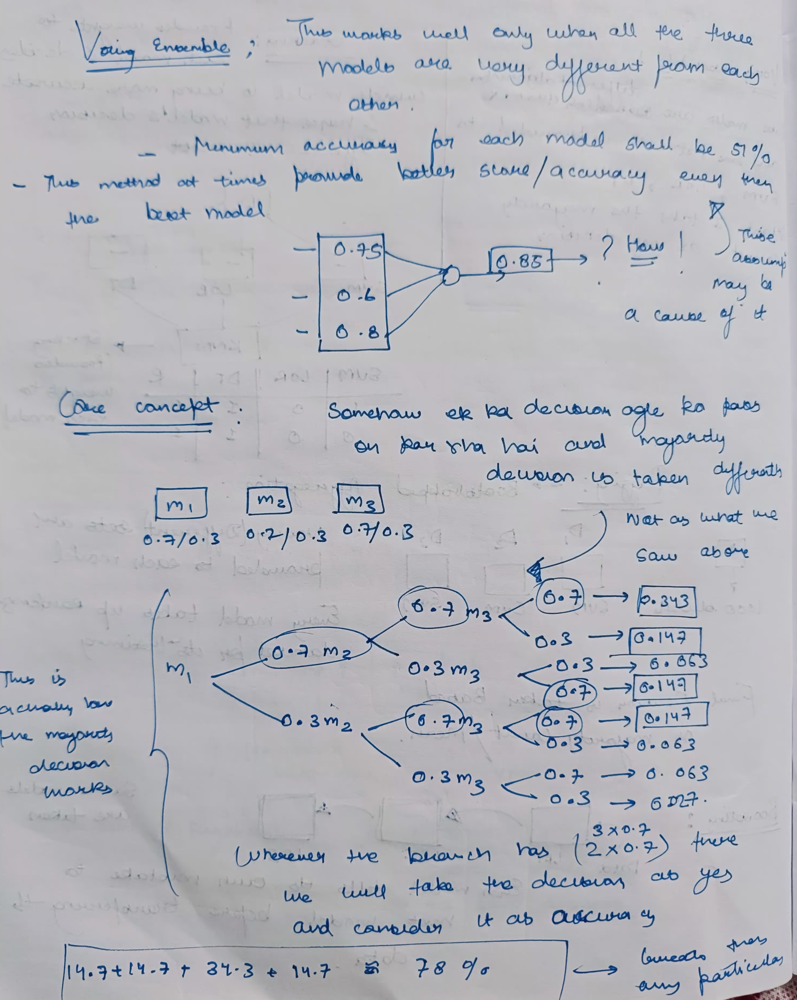

## MATHEMATICS BEHIND SVMs


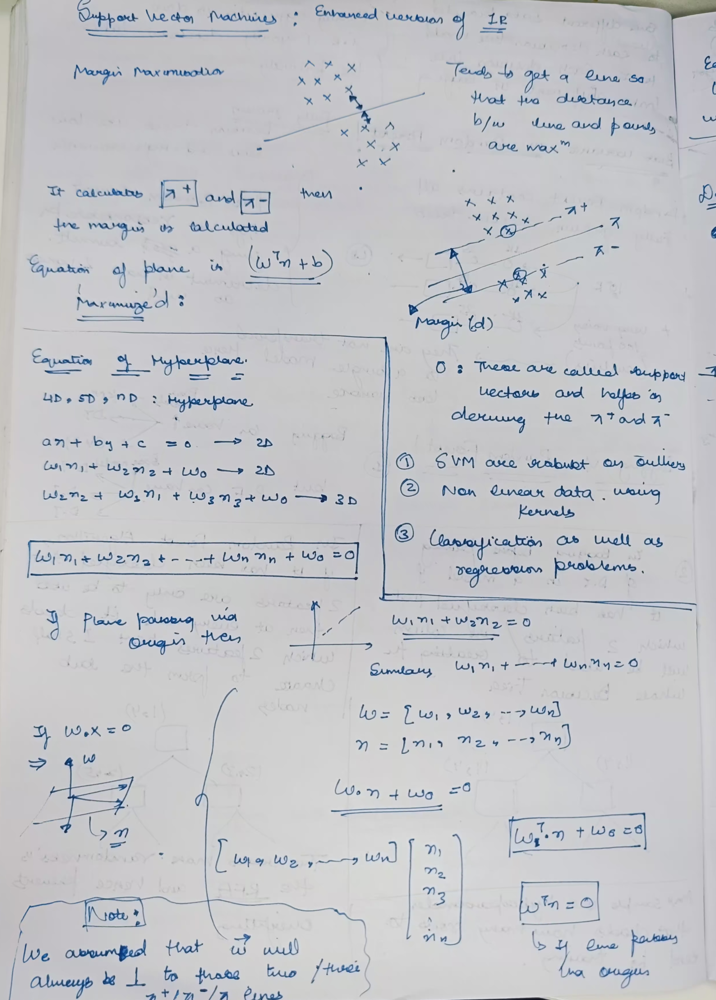

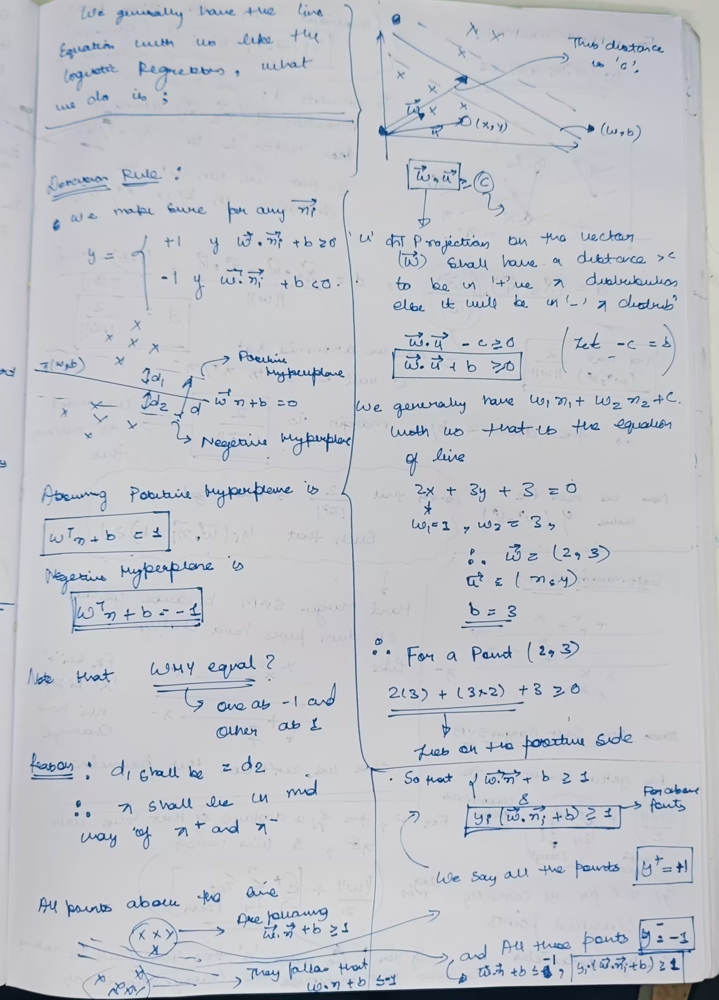

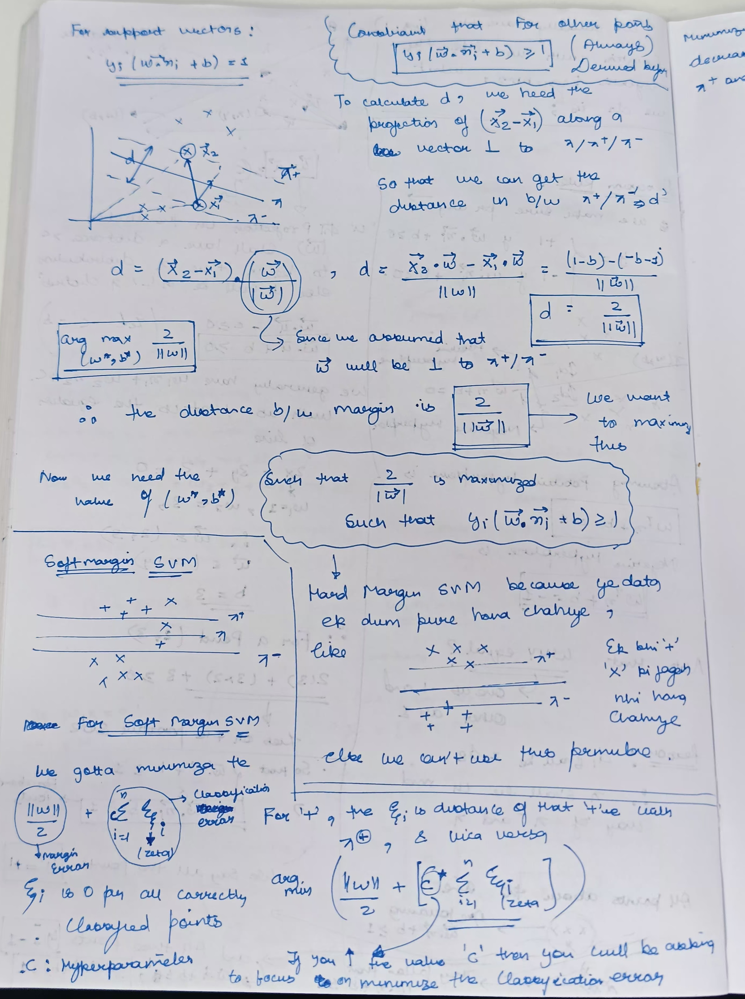

## Kernels are functions that are used in Kernel Trick SVM that performs classification/regression by making the datset linearly separable in higher dimensional kernal space

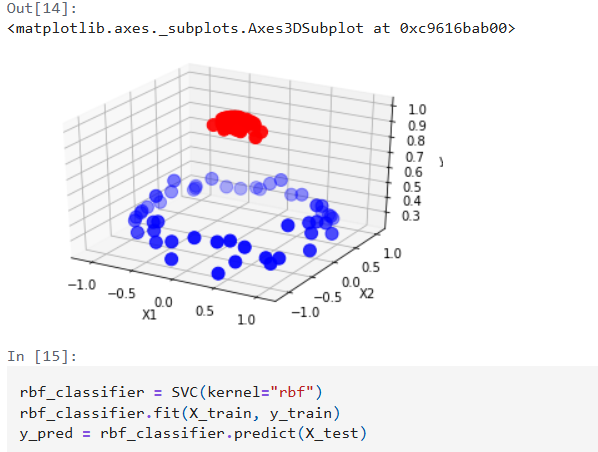

In [346]:
from sklearn.ensemble import BaggingClassifier, VotingClassifier, RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

ROW_SAMPLE_RATIO = 0.8
FEATURE_SAMPLE_RATIO = 0.6

bagged_svm = BaggingClassifier(
    estimator=SVC(kernel='rbf', probability=True, class_weight='balanced'),
    n_estimators=50,
    max_samples=ROW_SAMPLE_RATIO,
    max_features=FEATURE_SAMPLE_RATIO,
    bootstrap=True,
    bootstrap_features=True,
    random_state=42
)

bagged_knn = BaggingClassifier(
    estimator=KNeighborsClassifier(n_neighbors=5),
    n_estimators=50,
    max_samples=ROW_SAMPLE_RATIO,
    max_features=FEATURE_SAMPLE_RATIO,
    bootstrap=True,
    bootstrap_features=True,
    random_state=42
)

bagged_dt = BaggingClassifier(
    estimator=DecisionTreeClassifier(max_depth=4, class_weight='balanced'),
    n_estimators=50,
    max_samples=ROW_SAMPLE_RATIO,
    max_features=FEATURE_SAMPLE_RATIO,
    bootstrap=True,
    bootstrap_features=True,
    random_state=42
)

bagged_lr = BaggingClassifier(
    estimator=Pipeline([
        ('scaler', StandardScaler()),
        ('lr', LogisticRegression(class_weight='balanced'))
    ]),
    n_estimators=50,
    max_samples=ROW_SAMPLE_RATIO,
    max_features=FEATURE_SAMPLE_RATIO,
    bootstrap=True,
    bootstrap_features=True,
    random_state=42
)

random_forest = RandomForestClassifier(
    n_estimators=50,
    max_depth=4,
    class_weight='balanced',
    max_features=FEATURE_SAMPLE_RATIO,  
    random_state=42
)


ensemble = VotingClassifier(
    estimators=[
        ('svm', bagged_svm),
        ('knn', bagged_knn),
        ('dt', bagged_dt),
        ('lr', bagged_lr),
        ('rf', random_forest)  
    ],
    voting='soft',  
    n_jobs=-1       
)

## VOTING CLASSIFIER ON FEATURED DATASET 1

In [504]:
ensemble.fit(df_encoded,Y2)

VotingClassifier(estimators=[('svm',
                              BaggingClassifier(bootstrap_features=True,
                                                estimator=SVC(class_weight='balanced',
                                                              probability=True),
                                                max_features=0.6,
                                                max_samples=0.8,
                                                n_estimators=50,
                                                random_state=42)),
                             ('knn',
                              BaggingClassifier(bootstrap_features=True,
                                                estimator=KNeighborsClassifier(),
                                                max_features=0.6,
                                                max_samples=0.8,
                                                n_estimators=50,
                                                random_state=42)),...
                              BaggingClassifier(bootstrap_features=True,
                                                estimator=Pipeline(steps=[('scaler',
                                                                           StandardScaler()),
                                                                          ('lr',
                                                                           LogisticRegression(class_weight='balanced'))]),
                                                max_features=0.6,
                                                max_samples=0.8,
                                                n_estimators=50,
                                                random_state=42)),
                             ('rf',
                              RandomForestClassifier(class_weight='balanced',
                                                     max_depth=4,
                                                     max_features=0.6,
                                                     n_estimators=50,
                                                     random_state=42))],
                 n_jobs=-1, voting='soft')

In [327]:
Yp = ensemble.predict(df_encoded2)

In [328]:
from sklearn.metrics import accuracy_score

accuracy = accuracy_score(yt2,Yp)
print(f"Accuracy: {accuracy:.2f}")

Accuracy: 0.80


## VOTING CLASSIFIER ON FEATURED DATASET 2

In [506]:
ensemble.fit(A1,A2)

VotingClassifier(estimators=[('svm',
                              BaggingClassifier(bootstrap_features=True,
                                                estimator=SVC(class_weight='balanced',
                                                              probability=True),
                                                max_features=0.6,
                                                max_samples=0.8,
                                                n_estimators=50,
                                                random_state=42)),
                             ('knn',
                              BaggingClassifier(bootstrap_features=True,
                                                estimator=KNeighborsClassifier(),
                                                max_features=0.6,
                                                max_samples=0.8,
                                                n_estimators=50,
                                                random_state=42)),...
                              BaggingClassifier(bootstrap_features=True,
                                                estimator=Pipeline(steps=[('scaler',
                                                                           StandardScaler()),
                                                                          ('lr',
                                                                           LogisticRegression(class_weight='balanced'))]),
                                                max_features=0.6,
                                                max_samples=0.8,
                                                n_estimators=50,
                                                random_state=42)),
                             ('rf',
                              RandomForestClassifier(class_weight='balanced',
                                                     max_depth=4,
                                                     max_features=0.6,
                                                     n_estimators=50,
                                                     random_state=42))],
                 n_jobs=-1, voting='soft')

In [508]:
Yp2 = ensemble.predict(B1)

In [510]:
accuracy = accuracy_score(B2,Yp2)
print(f"Accuracy: {accuracy:.2f}")

Accuracy: 0.80


### Already explained the mathematical formulaes for this and its intuition above for calculation of F1 score , Recall, Precision and Confusion Matrix

In [330]:
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score

precision = precision_score(yt2, Yp)
recall = recall_score(yt2, Yp)
f1 = f1_score(yt2, Yp)

conf_mat = confusion_matrix(yt2, Yp)

print(f"Precision: {precision:.2f}")
print(f"Recall:    {recall:.2f}")
print(f"F1 Score:  {f1:.2f}")
print("\nConfusion Matrix:")
print(conf_mat)

Precision: 0.67
Recall:    0.68
F1 Score:  0.67

Confusion Matrix:
[[268  46]
 [ 44  92]]


## Trying on the Feature Engineered data df

In [332]:
X3 = data.drop('Purchase', axis=1)  
Y3 = data['Purchase'] 

In [333]:
from sklearn.preprocessing import OneHotEncoder
categorical_columns = ['Referral', 'Last_Ad_Seen']
encoder = OneHotEncoder(sparse_output=False, handle_unknown='ignore').set_output(transform="pandas")
encoded_data3 = encoder.fit_transform(X3[categorical_columns])
df_encoded3= pd.concat([X3.drop(categorical_columns, axis=1), encoded_data3], axis=1)
print(df_encoded3)

      Time_on_site  Pages_viewed  Clicked_ad  Cart_value  \
0             2.29          5.37           1       10.00   
1             7.49         16.36           0       25.52   
2             5.71         13.69           0       10.00   
3             1.23          3.22           1       41.49   
4             3.55         10.72           0       21.57   
...            ...           ...         ...         ...   
1795          4.99         11.27           0       53.20   
1796          3.92          8.20           0       46.06   
1797          4.63          8.95           0       38.75   
1798          7.90         23.95           0       70.82   
1799          3.40          7.08           0       45.49   

      Browser_Refresh_Rate  Referral_Direct  Referral_Facebook  \
0                   143.14              0.0                1.0   
1                   136.66              0.0                0.0   
2                    67.13              0.0                0.0   
3              

In [334]:
from sklearn.ensemble import BaggingClassifier, VotingClassifier, RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

ROW_SAMPLE_RATIO = 0.8
FEATURE_SAMPLE_RATIO = 0.6

bagged_svm = BaggingClassifier(
    estimator=SVC(kernel='rbf', probability=True, class_weight='balanced'),
    n_estimators=50,
    max_samples=ROW_SAMPLE_RATIO,
    max_features=FEATURE_SAMPLE_RATIO,
    bootstrap=True,
    bootstrap_features=True,
    random_state=42
)

bagged_knn = BaggingClassifier(
    estimator=KNeighborsClassifier(n_neighbors=5),
    n_estimators=50,
    max_samples=ROW_SAMPLE_RATIO,
    max_features=FEATURE_SAMPLE_RATIO,
    bootstrap=True,
    bootstrap_features=True,
    random_state=42
)

bagged_dt = BaggingClassifier(
    estimator=DecisionTreeClassifier(max_depth=4, class_weight='balanced'),
    n_estimators=50,
    max_samples=ROW_SAMPLE_RATIO,
    max_features=FEATURE_SAMPLE_RATIO,
    bootstrap=True,
    bootstrap_features=True,
    random_state=42
)

bagged_lr = BaggingClassifier(
    estimator=Pipeline([
        ('scaler', StandardScaler()),
        ('lr', LogisticRegression(class_weight='balanced'))
    ]),
    n_estimators=50,
    max_samples=ROW_SAMPLE_RATIO,
    max_features=FEATURE_SAMPLE_RATIO,
    bootstrap=True,
    bootstrap_features=True,
    random_state=42
)

random_forest = RandomForestClassifier(
    n_estimators=50,
    max_depth=4,
    class_weight='balanced',
    max_features=FEATURE_SAMPLE_RATIO,  
    random_state=42
)


ensemble2 = VotingClassifier(
    estimators=[
        ('svm', bagged_svm),
        ('knn', bagged_knn),
        ('dt', bagged_dt),
        ('lr', bagged_lr),
        ('rf', random_forest)  
    ],
    voting='soft',  
    n_jobs=-1       
)

In [335]:
ensemble2.fit(df_encoded3,Y3)

VotingClassifier(estimators=[('svm',
                              BaggingClassifier(bootstrap_features=True,
                                                estimator=SVC(class_weight='balanced',
                                                              probability=True),
                                                max_features=0.6,
                                                max_samples=0.8,
                                                n_estimators=50,
                                                random_state=42)),
                             ('knn',
                              BaggingClassifier(bootstrap_features=True,
                                                estimator=KNeighborsClassifier(),
                                                max_features=0.6,
                                                max_samples=0.8,
                                                n_estimators=50,
                                                random_state=42)),...
                              BaggingClassifier(bootstrap_features=True,
                                                estimator=Pipeline(steps=[('scaler',
                                                                           StandardScaler()),
                                                                          ('lr',
                                                                           LogisticRegression(class_weight='balanced'))]),
                                                max_features=0.6,
                                                max_samples=0.8,
                                                n_estimators=50,
                                                random_state=42)),
                             ('rf',
                              RandomForestClassifier(class_weight='balanced',
                                                     max_depth=4,
                                                     max_features=0.6,
                                                     n_estimators=50,
                                                     random_state=42))],
                 n_jobs=-1, voting='soft')

In [343]:
Yp2 = ensemble2.predict(df_encoded2)

In [345]:
accuracy = accuracy_score(yt2,Yp2)
print(f"Accuracy: {accuracy:.2f}")

Accuracy: 0.80


In [348]:
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score

precision = precision_score(yt2, Yp2)
recall = recall_score(yt2, Yp2)
f1 = f1_score(yt2, Yp2)

conf_mat = confusion_matrix(yt2, Yp2)

print(f"Precision: {precision:.2f}")
print(f"Recall:    {recall:.2f}")
print(f"F1 Score:  {f1:.2f}")
print("\nConfusion Matrix:")
print(conf_mat)

Precision: 0.67
Recall:    0.68
F1 Score:  0.67

Confusion Matrix:
[[268  46]
 [ 44  92]]


## ADABOOST ALGORITHM CLASSIFIER

AdaBoost (Adaptive Boosting) is a tree-based ensemble method, often using decision trees as weak learners (e.g., DecisionTreeClassifier in scikit-learn). Decision trees split on feature thresholds and are not sensitive to the scale of the data. As a result, scaling features like you would for logistic regression, SVMs, or k-nearest neighbors is not necessary.

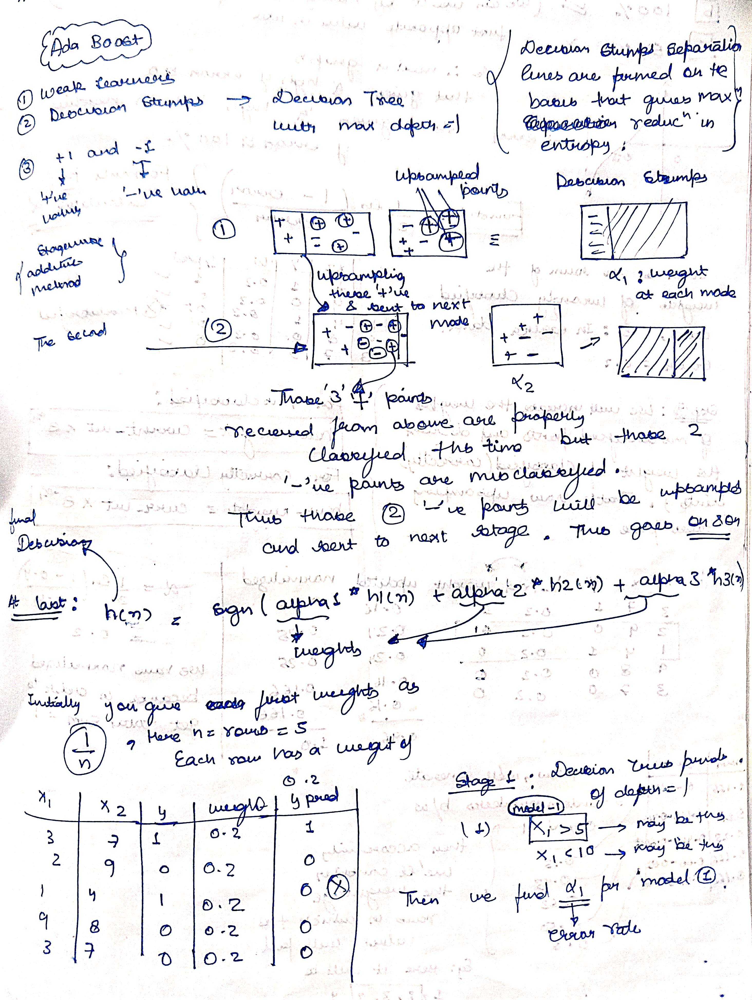

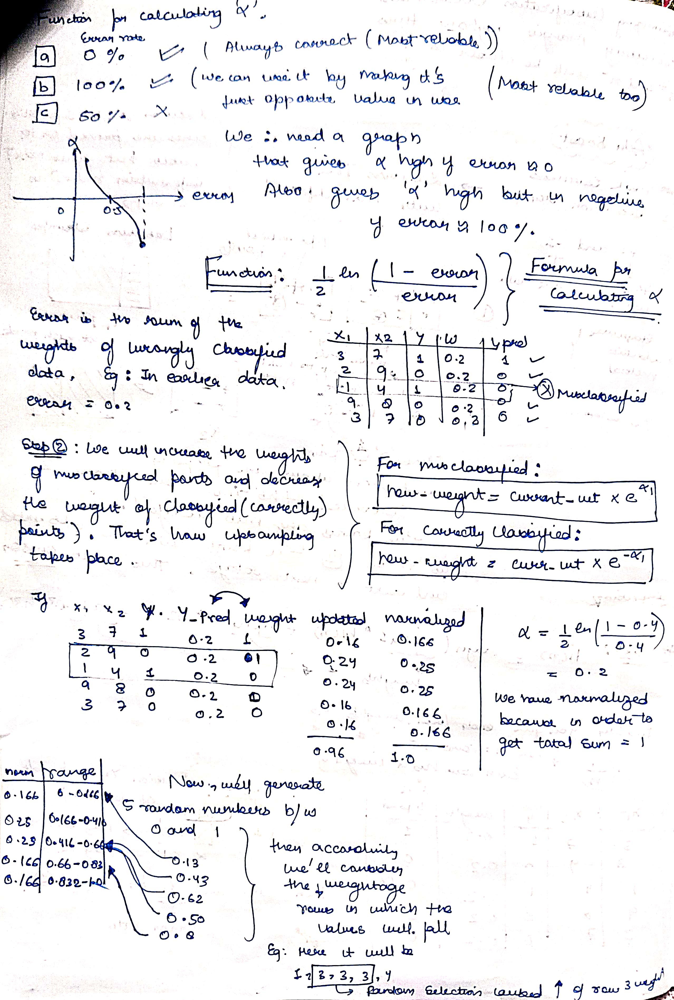

## Mathematic intuition behind the SAMME.R algorithm

### 1. Base Classifier Probabilities  
Each weak learner outputs a class probability distribution:

$$
P_{m,k}(x) = \Pr(y = k \mid x, h_m)
$$

### 2. Real-Valued Logit Outputs  
The confidence of the $m$-th weak learner for class $k$:

$$
f_{m,k}(x) = \frac{K-1}{K} \left( \log P_{m,k}(x) - \frac{1}{K} \sum_{j=1}^K \log P_{m,j}(x) \right)
$$

### 3. Strong Classifier Output (Additive Model)  
The strong classifier accumulates confidence across all learners:

$$
F_k(x) = \sum_{m=1}^M f_{m,k}(x)
$$

Final prediction is the class with the highest total score:

$$
\hat{y} = \arg\max_k F_k(x)
$$

### 4. Sample Weight Update (Exponential Loss)  
In SAMME.R, instead of directly adjusting weights like in discrete AdaBoost or SAMME, we implicitly update sample importance through the exponential loss framework using real-valued outputs from the weak classifiers.

The SAMME.R algorithm minimizes the exponential loss function for multiclass classification:
$$
\mathcal{L}(F) = \sum_{i=1}^N \exp\left( -\frac{K-1}{K} \left( F_{y_i}(x_i) - \frac{1}{K} \sum_{k=1}^K F_k(x_i) \right) \right)
$$
There’s no explicit reweighting of samples as in AdaBoost or SAMME.
The importance of each training example is encoded in how much the current additive model misclassifies or underconfidently classifies it.


In [354]:
from sklearn.ensemble import AdaBoostClassifier
base_estimator = DecisionTreeClassifier(max_depth=1, random_state=42)

adaboost = AdaBoostClassifier(
    estimator=base_estimator,
    n_estimators=50,
    learning_rate=1.0, 
    random_state=42,
    algorithm='SAMME.R'
)

adaboost.fit(df_encoded,Y2)

YPRED = adaboost.predict(df_encoded2)

accuracy = accuracy_score(yt2,YPRED)
print(f"Precision: {precision_score(yt2, YPRED):.4f}")
print(f"Recall: {recall_score(yt2, YPRED):.4f}")
print(f"F1 Score: {f1_score(yt2, YPRED):.4f}")

print("\nConfusion Matrix:")
print(confusion_matrix(yt2, YPRED))
print(f"AdaBoost Classifier Accuracy: {accuracy:.2f}")

E:\Anaconda\Lib\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Precision: 0.6518
Recall: 0.5368
F1 Score: 0.5887

Confusion Matrix:
[[275  39]
 [ 63  73]]
AdaBoost Classifier Accuracy: 0.77


In [355]:
import pandas as pd
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix

base_estimator2 = DecisionTreeClassifier(max_depth=1,random_state=42)

ada = AdaBoostClassifier(estimator=base_estimator2,algorithm='SAMME',random_state=42)

param_grid = {
    'n_estimators': [50, 100, 200,10,150], 
    'estimator__criterion': ['gini', 'entropy'],
}

grid_search = GridSearchCV(
    estimator=ada,
    param_grid=param_grid,
    cv=2,
    n_jobs=-1,
    verbose=2
)

grid_search.fit(df_encoded, Y2)

best_ada = grid_search.best_estimator_

YP_RED = best_ada.predict(df_encoded2)

print(f"Best Parameters: {grid_search.best_params_}")
print(f"Accuracy: {accuracy_score(yt2, YP_RED):.4f}")
print(f"Precision: {precision_score(yt2, YP_RED):.4f}")
print(f"Recall: {recall_score(yt2, YP_RED):.4f}")
print(f"F1 Score: {f1_score(yt2, YP_RED):.4f}")
print("\nConfusion Matrix:")
print(confusion_matrix(yt2, YP_RED))


Fitting 2 folds for each of 10 candidates, totalling 20 fits
Best Parameters: {'estimator__criterion': 'gini', 'n_estimators': 10}
Accuracy: 0.7933
Precision: 0.6617
Recall: 0.6471
F1 Score: 0.6543

Confusion Matrix:
[[269  45]
 [ 48  88]]


## XG BOOST ALGORITHMN ON OUR DATASET

#### How XGBoost Achieves "Parallelism" Despite Sequential Boosting
Boosting algorithms like Gradient Boosting build trees sequentially — each tree corrects the errors of the previous one. So the models themselves are not trained in parallel. But XGBoost achieves parallelization within the construction of each individual tree. XGBoost parallelizes the computation of the best split at each node of the decision tree.

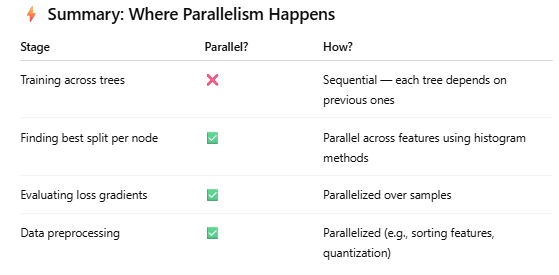

 Why This Works Well
Trees are still added sequentially, as in AdaBoost or Gradient Boosting.

But split-finding and computations within a tree are highly parallelized, making XGBoost much faster than naïve implementations.

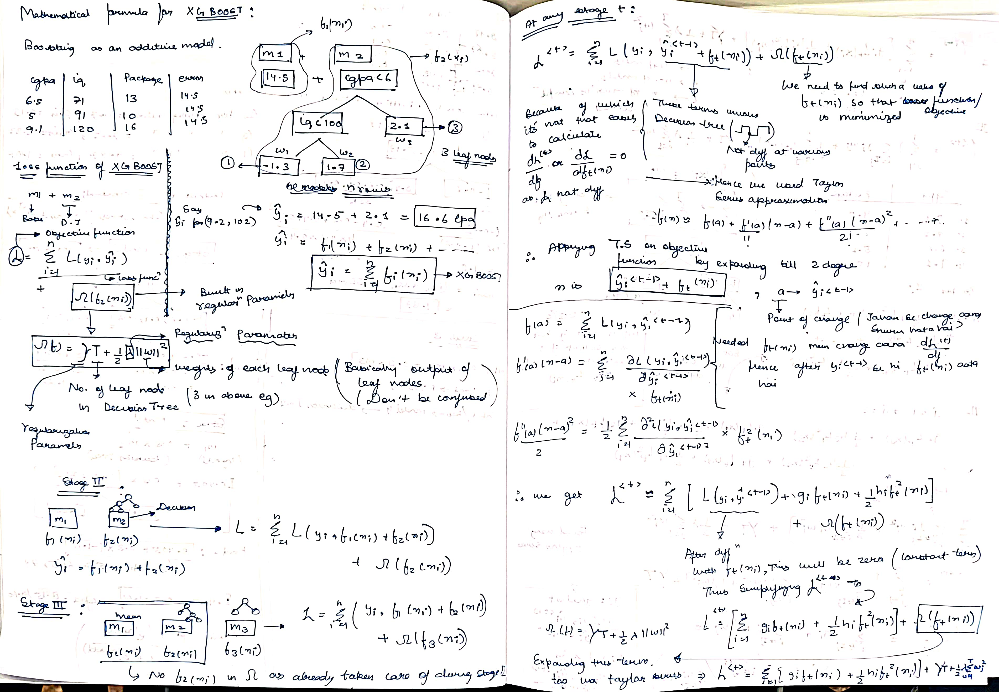

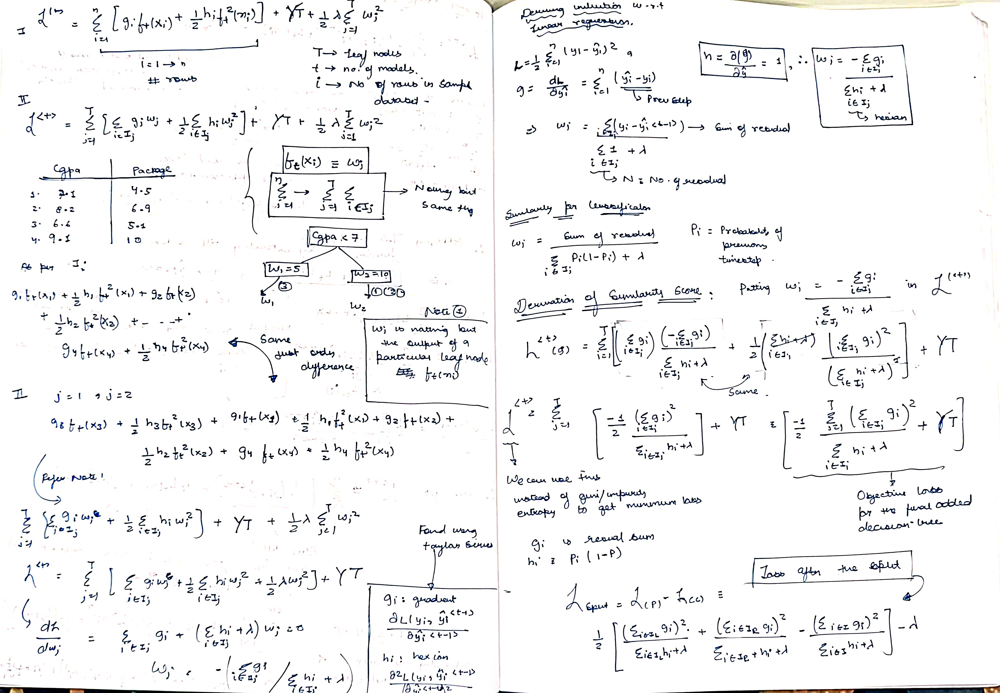

In [145]:
A = train.drop('Time_on_site', axis=1)
A

,Pages_viewed,Clicked_ad,Cart_value,Referral,Browser_Refresh_Rate,Last_Ad_Seen,Purchase
0,5.37,1,10.00,Facebook,143.14,D,1
1,16.36,0,25.52,Instagram,136.66,A,1
2,13.69,0,10.00,Google,67.13,C,0
3,3.22,1,41.49,Google,92.12,C,0
4,10.72,0,21.57,Direct,70.31,B,0
...,...,...,...,...,...,...,...
1795,11.27,0,53.20,Facebook,90.52,B,0
1796,8.20,0,46.06,Google,85.45,A,0
1797,8.95,0,38.75,Google,99.26,D,0
1798,23.95,0,70.82,Google,153.03,D,1


In [147]:
from sklearn.preprocessing import PowerTransformer
columns_to_transform = ['Cart_value', 'Browser_Refresh_Rate','Pages_viewed']
pt = PowerTransformer(method='yeo-johnson')
A[columns_to_transform] = pt.fit_transform(A[columns_to_transform])
A

,Pages_viewed,Clicked_ad,Cart_value,Referral,Browser_Refresh_Rate,Last_Ad_Seen,Purchase
0,-1.120781,1,-1.372675,Facebook,0.822039,D,1
1,0.660504,0,-0.274182,Instagram,0.698182,A,1
2,0.276983,0,-1.372675,Google,-0.640867,C,0
3,-1.573997,1,0.268370,Google,-0.157114,C,0
4,-0.179201,0,-0.466948,Direct,-0.579113,B,0
...,...,...,...,...,...,...,...
1795,-0.091965,0,0.536793,Facebook,-0.187989,B,0
1796,-0.598630,0,0.381973,Google,-0.285906,A,0
1797,-0.470075,0,0.193489,Google,-0.019477,D,0
1798,1.653368,0,0.837610,Google,1.010834,D,1


In [149]:
from sklearn.preprocessing import OneHotEncoder
categorical_columns = ['Referral', 'Last_Ad_Seen']
en = OneHotEncoder(sparse_output=False, handle_unknown='ignore').set_output(transform="pandas")
ed = en.fit_transform(A[categorical_columns])
dfe= pd.concat([A.drop(categorical_columns, axis=1), ed], axis=1)
print(dfe)

      Pages_viewed  Clicked_ad  Cart_value  Browser_Refresh_Rate  Purchase  \
0        -1.120781           1   -1.372675              0.822039         1   
1         0.660504           0   -0.274182              0.698182         1   
2         0.276983           0   -1.372675             -0.640867         0   
3        -1.573997           1    0.268370             -0.157114         0   
4        -0.179201           0   -0.466948             -0.579113         0   
...            ...         ...         ...                   ...       ...   
1795     -0.091965           0    0.536793             -0.187989         0   
1796     -0.598630           0    0.381973             -0.285906         0   
1797     -0.470075           0    0.193489             -0.019477         0   
1798      1.653368           0    0.837610              1.010834         1   
1799     -0.797552           0    0.368494              1.564053         0   

      Referral_Direct  Referral_Facebook  Referral_Google  Refe

In [151]:
A1=dfe.drop('Purchase', axis=1)
A2=dfe['Purchase']

In [153]:
B=test.copy()
B.head()

,Time_on_site,Pages_viewed,Clicked_ad,Cart_value,Referral,Browser_Refresh_Rate,Last_Ad_Seen,Purchase
0,3.33,12.76,0,27.66,Google,131.60,C,0
1,3.75,10.20,0,15.05,Direct,41.63,C,0
2,6.55,16.40,0,105.27,Facebook,98.72,A,1
3,6.42,19.68,1,21.17,Direct,180.20,D,0
4,8.38,30.59,0,91.31,Instagram,58.70,B,1


In [155]:
B['Time_on_site_zscore']=(B['Time_on_site']-B['Time_on_site'].mean())/B['Time_on_site'].std()

In [156]:
B = B.drop('Time_on_site', axis=1)
B

,Pages_viewed,Clicked_ad,Cart_value,Referral,Browser_Refresh_Rate,Last_Ad_Seen,Purchase,Time_on_site_zscore
0,12.76,0,27.66,Google,131.60,C,0,-0.711908
1,10.20,0,15.05,Direct,41.63,C,0,-0.537779
2,16.40,0,105.27,Facebook,98.72,A,1,0.623075
3,19.68,1,21.17,Direct,180.20,D,0,0.569178
4,30.59,0,91.31,Instagram,58.70,B,1,1.381776
...,...,...,...,...,...,...,...,...
445,5.81,1,24.87,Google,65.37,D,0,-1.130644
446,13.60,0,21.42,Facebook,92.84,A,0,0.710139
447,10.62,0,50.71,Google,148.14,A,0,-0.525342
448,8.17,1,30.11,Instagram,43.91,C,0,-0.500466


In [159]:
from sklearn.preprocessing import PowerTransformer
columns_to_transform = ['Cart_value', 'Browser_Refresh_Rate','Pages_viewed']
pt = PowerTransformer(method='yeo-johnson')
B[columns_to_transform] = pt.fit_transform(B[columns_to_transform])
B

,Pages_viewed,Clicked_ad,Cart_value,Referral,Browser_Refresh_Rate,Last_Ad_Seen,Purchase,Time_on_site_zscore
0,0.102845,0,-0.244190,Google,0.626684,C,0,-0.711908
1,-0.268699,0,-0.940195,Direct,-1.167401,C,0,-0.537779
2,0.586201,0,1.201872,Facebook,-0.029910,A,1,0.623075
3,0.987779,1,-0.547960,Direct,1.598469,D,0,0.569178
4,2.167897,0,1.054489,Instagram,-0.827745,B,1,1.381776
...,...,...,...,...,...,...,...,...
445,-0.998591,1,-0.364521,Google,-0.694903,D,0,-1.130644
446,0.218552,0,-0.534547,Facebook,-0.147238,A,0,0.710139
447,-0.205567,0,0.428069,Google,0.957260,A,0,-0.525342
448,-0.588383,1,-0.148609,Instagram,-1.122064,C,0,-0.500466


In [161]:
from sklearn.preprocessing import OneHotEncoder
categorical_columns = ['Referral', 'Last_Ad_Seen']
en2 = OneHotEncoder(sparse_output=False, handle_unknown='ignore').set_output(transform="pandas")
ed2 = en2.fit_transform(B[categorical_columns])
dfe2= pd.concat([B.drop(categorical_columns, axis=1), ed2], axis=1)
print(dfe2)

     Pages_viewed  Clicked_ad  Cart_value  Browser_Refresh_Rate  Purchase  \
0        0.102845           0   -0.244190              0.626684         0   
1       -0.268699           0   -0.940195             -1.167401         0   
2        0.586201           0    1.201872             -0.029910         1   
3        0.987779           1   -0.547960              1.598469         0   
4        2.167897           0    1.054489             -0.827745         1   
..            ...         ...         ...                   ...       ...   
445     -0.998591           1   -0.364521             -0.694903         0   
446      0.218552           0   -0.534547             -0.147238         0   
447     -0.205567           0    0.428069              0.957260         0   
448     -0.588383           1   -0.148609             -1.122064         0   
449     -0.262646           0    1.529735              0.643868         0   

     Time_on_site_zscore  Referral_Direct  Referral_Facebook  Referral_Goog

In [163]:
B1=dfe2.drop('Purchase', axis=1)
B2=dfe2['Purchase']

## Gradient Boosting Algorithm

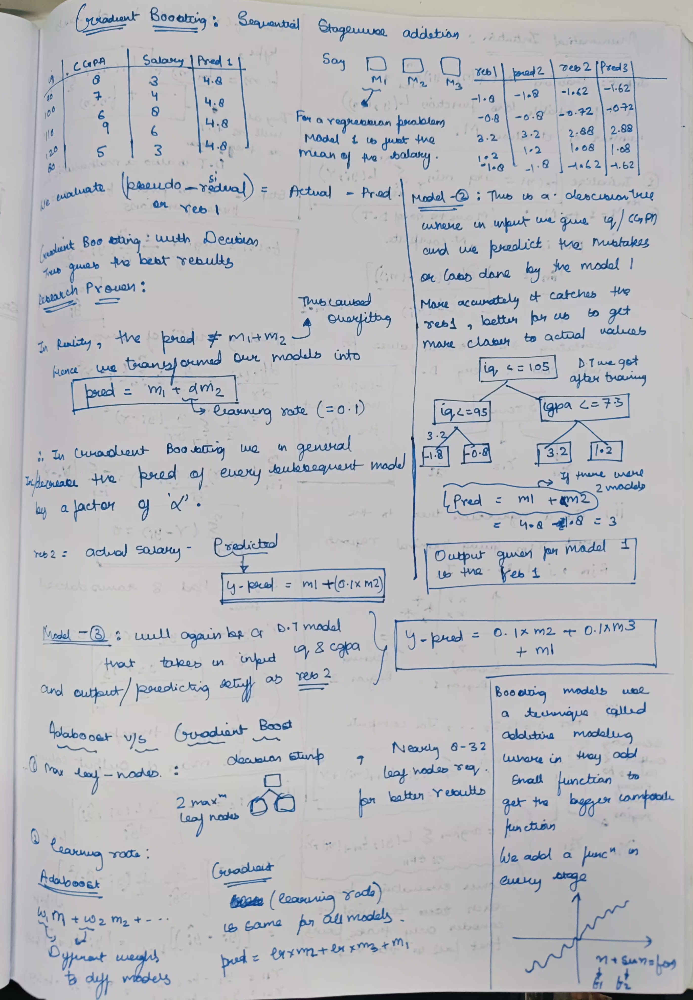

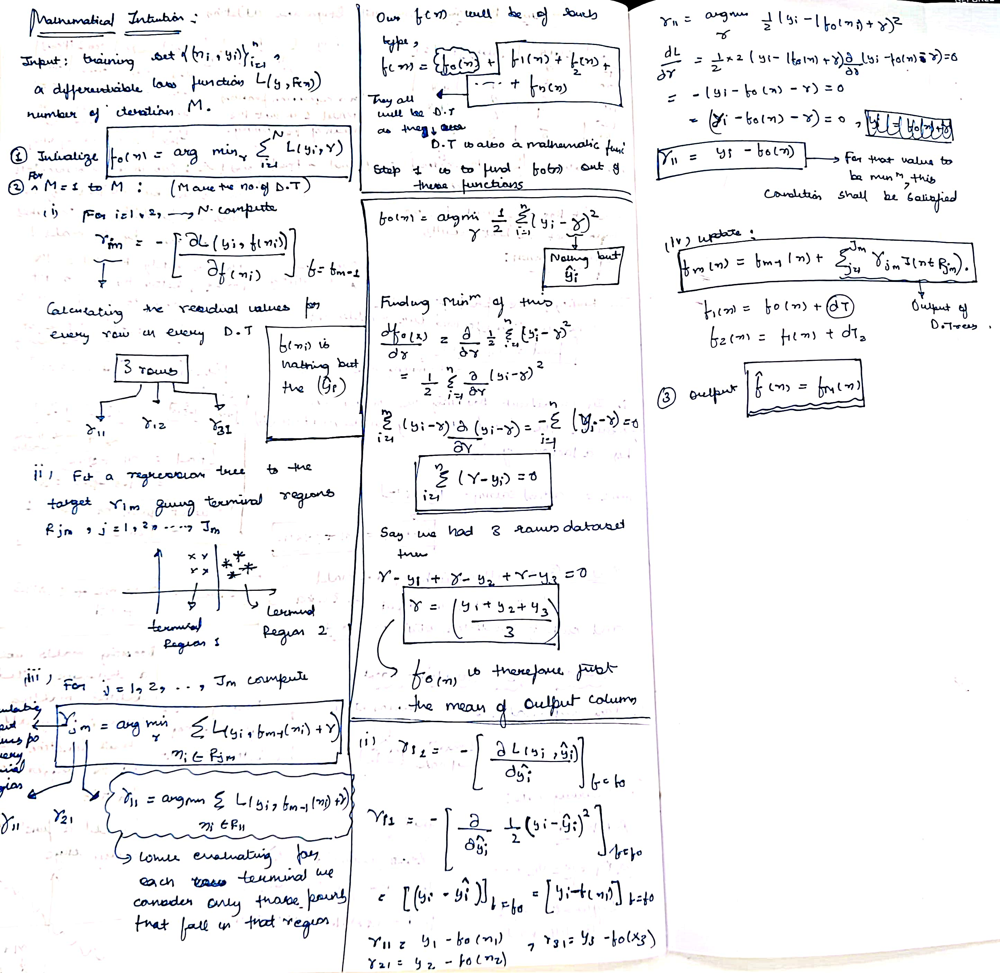

In [455]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix

gb_model = GradientBoostingClassifier(
    learning_rate=0.1,
    n_estimators=100,
    max_depth=3,
    subsample=1.0,
    random_state=42,
)

gb_model.fit(df_encoded3, Y2)

YPRE_GB = gb_model.predict(df_encoded2)

print(f"GBoost Accuracy: {accuracy_score(yt2, YPRE_GB):.2f}")
print(f"Precision: {precision_score(yt2, YPRE_GB):.2f}")
print(f"Recall: {recall_score(yt2, YPRE_GB):.2f}")
print(f"F1 Score: {f1_score(yt2, YPRE_GB):.2f}")
print("Confusion Matrix:")
print(confusion_matrix(yt2, YPRE_GB))


GBoost Accuracy: 0.79
Precision: 0.66
Recall: 0.62
F1 Score: 0.64
Confusion Matrix:
[[271  43]
 [ 52  84]]


## GRID SEARCH CV using Gradient Boosting

In [453]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV

gbm = GradientBoostingClassifier(
    random_state=42,
    subsample=1.0,
    max_features=None  
)

param_grid = {
    'n_estimators': [50, 100, 200, 150],
    'learning_rate': [0.01, 0.1, 0.5, 1.0],
    'max_depth': [3, 5, 7],
    'subsample': [0.8, 1.0],
    'max_features': ['sqrt', 'log2', None]  
}

grid_search = GridSearchCV(
    estimator=gbm,
    param_grid=param_grid,
    cv=5,
    n_jobs=-1,
    verbose=2
)

grid_search.fit(df_encoded3, Y2)

best_xgb = grid_search.best_estimator_

YPRED = best_xgb.predict((df_encoded2))

print(f"Best Parameters: {grid_search.best_params_}")
print(f"Accuracy: {accuracy_score(yt2, YPRED):.4f}")
print(f"Precision: {precision_score(yt2, YPRED):.4f}")
print(f"Recall: {recall_score(yt2, YPRED):.4f}")
print(f"F1 Score: {f1_score(yt2, YPRED):.4f}")
print("\nConfusion Matrix:")
print(confusion_matrix(yt2, YPRED))

Fitting 5 folds for each of 288 candidates, totalling 1440 fits


E:\Anaconda\Lib\site-packages\numpy\ma\core.py:2820: RuntimeWarning: invalid value encountered in cast
  _data = np.array(data, dtype=dtype, copy=copy,


Best Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'max_features': 'sqrt', 'n_estimators': 50, 'subsample': 1.0}
Accuracy: 0.7956
Precision: 0.6930
Recall: 0.5809
F1 Score: 0.6320

Confusion Matrix:
[[279  35]
 [ 57  79]]


 # ROC CURVE : RECIEVER OPERATING CHARECTERSTIC CURVE

A ROC curve is a graphical plot used to evaluate the performance of a binary classification model by showing the trade-off between:

✅ True Positive Rate (TPR) (Sensitivity, Recall)

❌ False Positive Rate (FPR)

## True Positive Rate (TPR)
$$TPR = \frac{TP}{TP + FN}$$

## False Positive Rate (FPR)  
$$FPR = \frac{FP}{FP + TN}$$


## ROC CURVES FOR THE VARIOUS MODELS USED TILL NOW 

<Figure size 800x600 with 0 Axes>

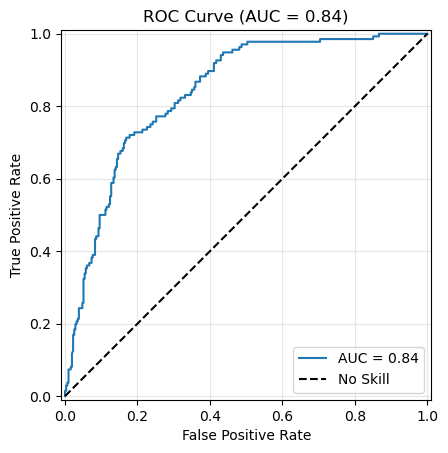

ROC AUC Score: 0.839

Gradient Boosting Accuracy: 0.79
Precision: 0.66
Recall: 0.62
F1 Score: 0.64
Confusion Matrix:
[[271  43]
 [ 52  84]]


In [435]:
from sklearn.metrics import roc_curve, RocCurveDisplay, roc_auc_score
import matplotlib.pyplot as plt

y_proba = gbc.predict_proba(df_encoded2)[:, 1]

fpr, tpr, thresholds = roc_curve(yt2, y_proba)
auc_score = roc_auc_score(yt2, y_proba)

plt.figure(figsize=(8, 6))
RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=auc_score).plot()
plt.plot([0, 1], [0, 1], 'k--', label='No Skill')
plt.title(f'ROC Curve (AUC = {auc_score:.2f})')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.grid(alpha=0.3)
plt.show()

print(f"ROC AUC Score: {auc_score:.3f}")

print(f"\nGradient Boosting Accuracy: {accuracy_score(yt2, YPRE_D):.2f}")
print(f"Precision: {precision_score(yt2, YPRE_D):.2f}")
print(f"Recall: {recall_score(yt2, YPRE_D):.2f}")
print(f"F1 Score: {f1_score(yt2, YPRE_D):.2f}")
print("Confusion Matrix:")
print(confusion_matrix(yt2, YPRE_D))


E:\Anaconda\Lib\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


<Figure size 800x600 with 0 Axes>

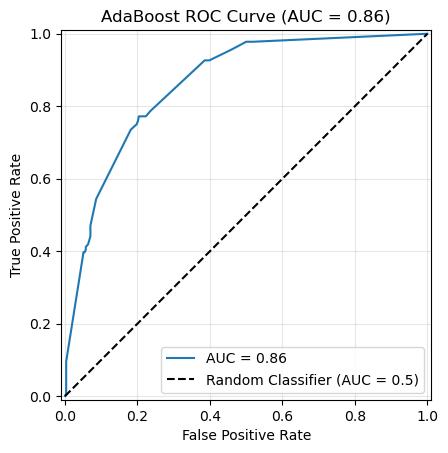

AdaBoost Classifier Accuracy: 0.80
ROC AUC Score: 0.862


In [463]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import (accuracy_score, roc_curve, 
                            RocCurveDisplay, roc_auc_score)
import matplotlib.pyplot as plt

base_estimator = DecisionTreeClassifier(max_depth=1, random_state=42)

adaboost = AdaBoostClassifier(
    estimator=base_estimator,
    n_estimators=5,
    learning_rate=1.0, 
    random_state=42,
    algorithm='SAMME.R'
)

adaboost.fit(df_encoded, Y2)

YPRED = adaboost.predict(df_encoded2)
y_proba = adaboost.predict_proba(df_encoded2)[:, 1]  

fpr, tpr, thresholds = roc_curve(yt2, y_proba)
auc_score = roc_auc_score(yt2, y_proba)

plt.figure(figsize=(8, 6))
RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=auc_score).plot()
plt.plot([0, 1], [0, 1], 'k--', label='Random Classifier (AUC = 0.5)')
plt.title(f'AdaBoost ROC Curve (AUC = {auc_score:.2f})')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.grid(alpha=0.3)
plt.show()

# Print metrics
print(f"AdaBoost Classifier Accuracy: {accuracy_score(yt2, YPRED):.2f}")
print(f"ROC AUC Score: {auc_score:.3f}")


<Figure size 800x600 with 0 Axes>

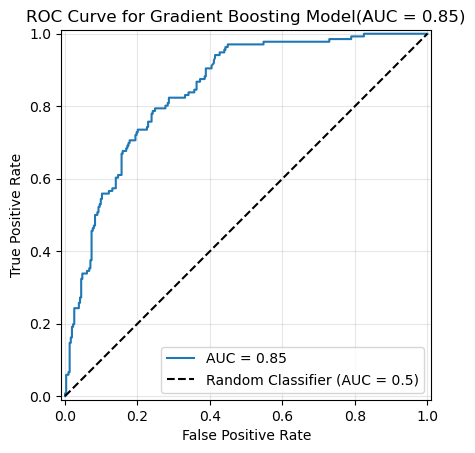


ROC AUC Score: 0.845

XGBoost Accuracy: 0.78
Precision: 0.67
Recall: 0.57
F1 Score: 0.61
Confusion Matrix:
[[276  38]
 [ 59  77]]


In [431]:
from sklearn.metrics import roc_curve, RocCurveDisplay, roc_auc_score
import matplotlib.pyplot as plt

y_proba = xgb_model.predict_proba(B1)[:, 1]  

fpr, tpr, thresholds = roc_curve(B2, y_proba)  
auc_score = roc_auc_score(B2, y_proba)  

plt.figure(figsize=(8, 6))
RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=auc_score).plot() 
plt.plot([0, 1], [0, 1], 'k--', label='Random Classifier (AUC = 0.5)')  
plt.title(f'ROC Curve for Gradient Boosting Model(AUC = {auc_score:.2f})')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.grid(alpha=0.3)
plt.show()

print(f"\nROC AUC Score: {auc_score:.3f}")
print(f"\nXGBoost Accuracy: {accuracy_score(B2, YPRE_XGB):.2f}")
print(f"Precision: {precision_score(B2, YPRE_XGB):.2f}")
print(f"Recall: {recall_score(B2, YPRE_XGB):.2f}")
print(f"F1 Score: {f1_score(B2, YPRE_XGB):.2f}")
print("Confusion Matrix:")
print(confusion_matrix(B2, YPRE_XGB))


<Figure size 800x600 with 0 Axes>

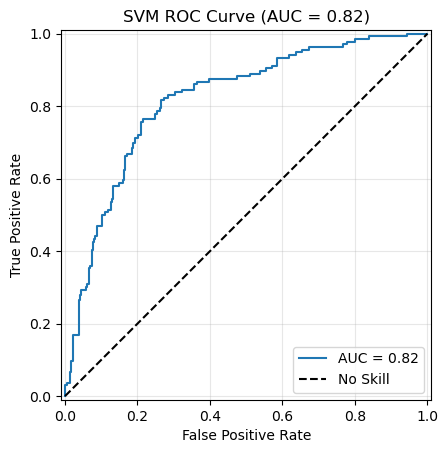

SVM Accuracy: 0.77
Precision: 0.67
Recall: 0.47
F1 Score: 0.55
Confusion Matrix:
[[282  32]
 [ 72  64]]


In [426]:
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, roc_curve, roc_auc_score, RocCurveDisplay
import matplotlib.pyplot as plt

svm_model = SVC(
    kernel='rbf',             
    C=1.0,
    probability=True,
    random_state=42
)

svm_model.fit(A1, A2)

YPRE_SVM = svm_model.predict(B1)

y_proba = svm_model.predict_proba(B1)[:, 1]

fpr, tpr, thresholds = roc_curve(B2, y_proba)
roc_auc = roc_auc_score(B2, y_proba)

plt.figure(figsize=(8,6))
RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc).plot()
plt.plot([0,1], [0,1], 'k--', label='No Skill')
plt.title(f'SVM ROC Curve (AUC = {roc_auc:.2f})')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.grid(alpha=0.3)
plt.show()

print(f"SVM Accuracy: {accuracy_score(B2, YPRE_SVM):.2f}")
print(f"Precision: {precision_score(B2, YPRE_SVM):.2f}")
print(f"Recall: {recall_score(B2, YPRE_SVM):.2f}")
print(f"F1 Score: {f1_score(B2, YPRE_SVM):.2f}")
print("Confusion Matrix:")
print(confusion_matrix(B2, YPRE_SVM))


<Figure size 800x600 with 0 Axes>

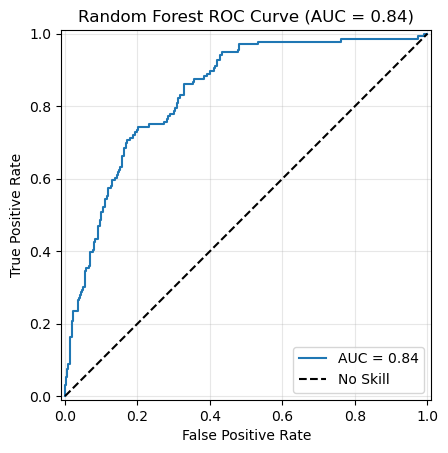

Random Forest Accuracy: 0.78
Precision: 0.60
Recall: 0.74
F1 Score: 0.67
Confusion Matrix:
[[248  66]
 [ 35 101]]


In [473]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, roc_curve, roc_auc_score, RocCurveDisplay
import matplotlib.pyplot as plt

rf_model = RandomForestClassifier(
    n_estimators=150,        
    max_depth=8,          
    min_samples_split=5,  
    random_state=42,      
    class_weight='balanced' 
)

rf_model.fit(A1, A2)


YPRE_RF = rf_model.predict(B1)
y_proba = rf_model.predict_proba(B1)[:, 1]  

fpr, tpr, thresholds = roc_curve(B2, y_proba)
roc_auc = roc_auc_score(B2, y_proba)

plt.figure(figsize=(8, 6))
RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc).plot()
plt.plot([0, 1], [0, 1], 'k--', label='No Skill')
plt.title(f'Random Forest ROC Curve (AUC = {roc_auc:.2f})')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.grid(alpha=0.3)
plt.show()

print(f"Random Forest Accuracy: {accuracy_score(B2, YPRE_RF):.2f}")
print(f"Precision: {precision_score(B2, YPRE_RF):.2f}")
print(f"Recall: {recall_score(B2, YPRE_RF):.2f}")
print(f"F1 Score: {f1_score(B2, YPRE_RF):.2f}")
print("Confusion Matrix:")
print(confusion_matrix(B2, YPRE_RF))

<Figure size 800x600 with 0 Axes>

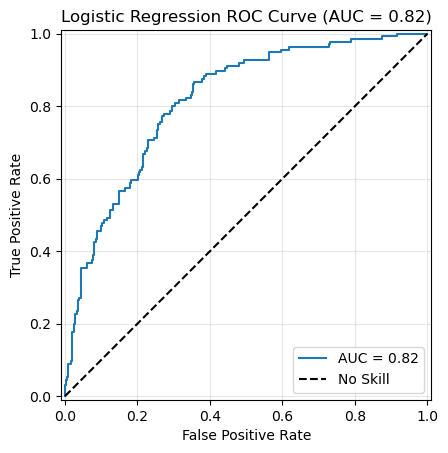

Logistic Regression Accuracy: 0.77
Precision: 0.66
Recall: 0.49
F1 Score: 0.56
Confusion Matrix:
[[280  34]
 [ 70  66]]


In [497]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, roc_curve, roc_auc_score, RocCurveDisplay
import matplotlib.pyplot as plt

logreg_model = LogisticRegression(
    C=1,
    penalty='elasticnet',
    l1_ratio=0.5,
    solver='saga',
    max_iter=1000,
    random_state=42
)

logreg_model.fit(A1, A2)

YPRE_LR = logreg_model.predict(B1)
y_proba = logreg_model.predict_proba(B1)[:, 1] 

fpr, tpr, thresholds = roc_curve(B2, y_proba)
roc_auc = roc_auc_score(B2, y_proba)

plt.figure(figsize=(8, 6))
RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc).plot()
plt.plot([0, 1], [0, 1], 'k--', label='No Skill')
plt.title(f'Logistic Regression ROC Curve (AUC = {roc_auc:.2f})')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.grid(alpha=0.3)
plt.show()

print(f"Logistic Regression Accuracy: {accuracy_score(B2, YPRE_LR):.2f}")
print(f"Precision: {precision_score(B2, YPRE_LR):.2f}")
print(f"Recall: {recall_score(B2, YPRE_LR):.2f}")
print(f"F1 Score: {f1_score(B2, YPRE_LR):.2f}")
print("Confusion Matrix:")
print(confusion_matrix(B2, YPRE_LR))


<Figure size 800x600 with 0 Axes>

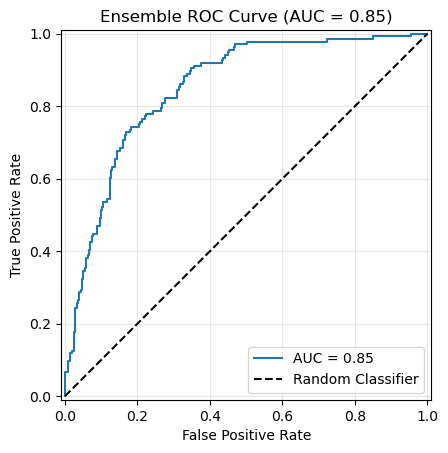

Voting Ensemble ROC AUC: 0.851
Accuracy: 0.80


In [521]:
from sklearn.metrics import roc_curve, RocCurveDisplay, roc_auc_score, accuracy_score
import matplotlib.pyplot as plt

y_proba = ensemble.predict_proba(B1)[:, 1]  

fpr, tpr, thresholds = roc_curve(B2, y_proba)  
roc_auc = roc_auc_score(B2, y_proba)           

plt.figure(figsize=(8, 6))
RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc).plot()
plt.plot([0, 1], [0, 1], 'k--', label='Random Classifier')
plt.title(f'Ensemble ROC Curve (AUC = {roc_auc:.2f})')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.grid(alpha=0.3)
plt.show()

Yp2 = ensemble.predict(B1)                  
accuracy = accuracy_score(B2, Yp2)          

print(f"Voting Ensemble ROC AUC: {roc_auc:.3f}")
print(f"Accuracy: {accuracy:.2f}")


# NEURAL NETWORKS

## Logic in Neural Networks : Mathematics and its intuition

<a name='3'></a>
## General Architecture of the learning algorithm ##

You will build a Logistic Regression, using a Neural Network mindset. The following Figure explains why **Logistic Regression is actually a very simple Neural Network!**

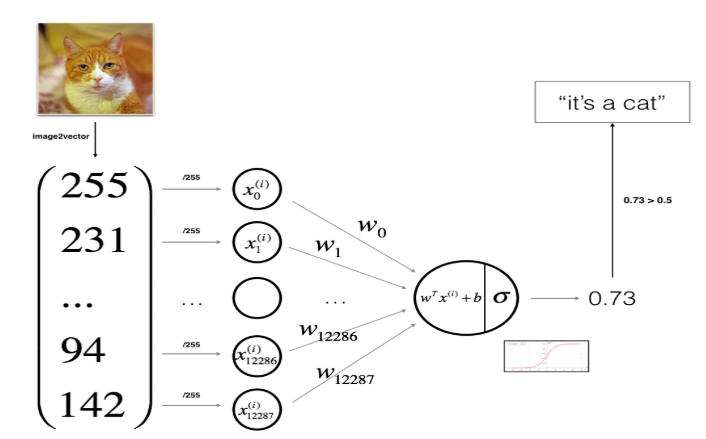

**Mathematical expression of the algorithm**:

For one example $x^{(i)}$:
$$z^{(i)} = w^T x^{(i)} + b \tag{1}$$
$$\hat{y}^{(i)} = a^{(i)} = sigmoid(z^{(i)})\tag{2}$$ 
$$ \mathcal{L}(a^{(i)}, y^{(i)}) =  - y^{(i)}  \log(a^{(i)}) - (1-y^{(i)} )  \log(1-a^{(i)})\tag{3}$$

The cost is then computed by summing over all training examples:
$$ J = \frac{1}{m} \sum_{i=1}^m \mathcal{L}(a^{(i)}, y^{(i)})\tag{6}$$

**Key steps**:
    - Initialize the parameters of the model
    - Learn the parameters for the model by minimizing the cost  
    - Use the learned parameters to make predictions (on the test set)
    - Analyse the results and conclude

Implement `sigmoid()`. As you've seen in the figure above, you need to compute $sigmoid(z) = \frac{1}{1 + e^{-z}}$ for $z = w^T x + b$ to make predictions. Use np.exp().

<a name='ex-4'></a>
### Initialize with zeros
Implement parameter initialization in the cell below. You have to initialize w as a vector of zeros. If you don't know what numpy function to use, look up np.zeros() in the Numpy library's documentation.

<a name='4-3'></a>
### Forward and Backward propagation

Now that your parameters are initialized, you can do the "forward" and "backward" propagation steps for learning the parameters.

<a name='ex-5'></a>
### Propagate
Implement a function `propagate()` that computes the cost function and its gradient.

Forward Propagation:
- You get X
- You compute $A = \sigma(w^T X + b) = (a^{(1)}, a^{(2)}, ..., a^{(m-1)}, a^{(m)})$
- You calculate the cost function: $J = -\frac{1}{m}\sum_{i=1}^{m}(y^{(i)}\log(a^{(i)})+(1-y^{(i)})\log(1-a^{(i)}))$

Here are the two formulas you will be using: 

$$ \frac{\partial J}{\partial w} = \frac{1}{m}X(A-Y)^T$$
$$ \frac{\partial J}{\partial b} = \frac{1}{m} \sum_{i=1}^m (a^{(i)}-y^{(i)})$$

<a name='4-4'></a>
### Optimization
- You have initialized your parameters.
- You are also able to compute a cost function and its gradient.
- Now, you want to update the parameters using gradient descent.

<a name='ex-6'></a>
### Optimize
Writing down the optimization function. The goal is to learn $w$ and $b$ by minimizing the cost function $J$. For a parameter $\theta$, the update rule is $ \theta = \theta - \alpha \text{ } d\theta$, where $\alpha$ is the learning rate.

<a name='ex-7'></a>
### Predict
The previous function will output the learned w and b. We are able to use w and b to predict the labels for a dataset X. Implement the `predict()` function. There are two steps to computing predictions:

1. Calculate $\hat{Y} = A = \sigma(w^T X + b)$

2. Convert the entries of a into 0 (if activation <= 0.5) or 1 (if activation > 0.5), stores the predictions in a vector `Y_prediction`. If you wish, you can use an `if`/`else` statement in a `for` loop (though there is also a way to vectorize this). 